In [ ]:
import pandas as pd
import numpy as np

In [ ]:
ds = '/content/Crime_Data_from_2020_to_Present.csv'
pd.options.display.max_columns = None
d = pd.read_csv(ds)
d.head(2)

<ipython-input-5-d43a09ddd9de>:3: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  d = pd.read_csv(ds)


,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON
0,190326475,03/01/2020 12:00:00 AM,03/01/2020 12:00:00 AM,2130.0,7.0,Wilshire,784.0,1.0,510.0,VEHICLE - STOLEN,NaN,0.0,M,O,101.0,STREET,NaN,NaN,AA,Adult Arrest,510.0,998.0,NaN,NaN,1900 S LONGWOOD AV,NaN,34.0375,-118.3506
1,200106753,02/09/2020 12:00:00 AM,02/08/2020 12:00:00 AM,1800.0,1.0,Central,182.0,1.0,330.0,BURGLARY FROM VEHICLE,1822 1402 0344,47.0,M,O,128.0,BUS STOP/LAYOVER (ALSO QUERY 124),NaN,NaN,IC,Invest Cont,330.0,998.0,NaN,NaN,1000 S FLOWER ST,NaN,34.0444,-118.2628


1ST EDITED AREA

<ipython-input-6-1344d9a5516a>:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=null_percent.index, y=null_percent.values, palette='coolwarm')


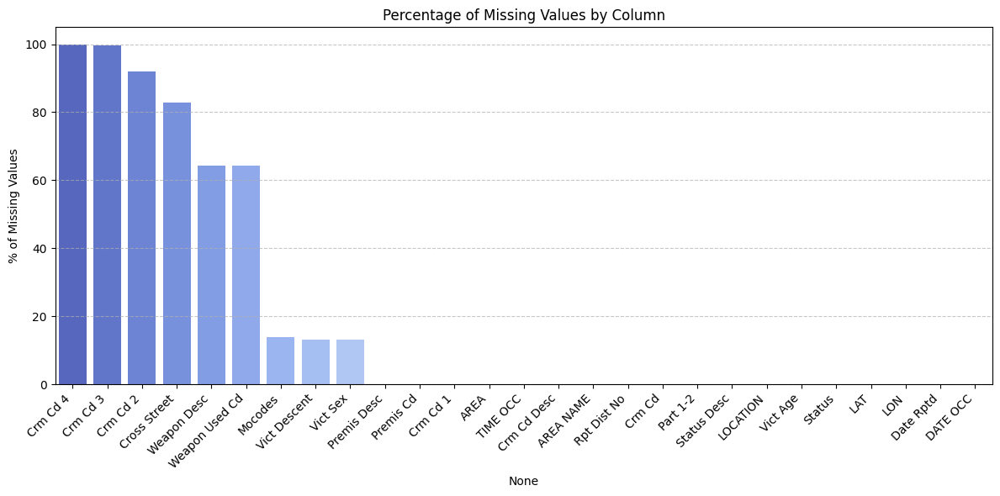

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate % of nulls per column
null_percent = d.isnull().mean() * 100
null_percent = null_percent[null_percent > 0].sort_values(ascending=False)

# Plot
plt.figure(figsize=(12, 6))
sns.barplot(x=null_percent.index, y=null_percent.values, palette='coolwarm')
plt.xticks(rotation=45, ha='right')
plt.ylabel('% of Missing Values')
plt.title('Percentage of Missing Values by Column')
plt.tight_layout()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


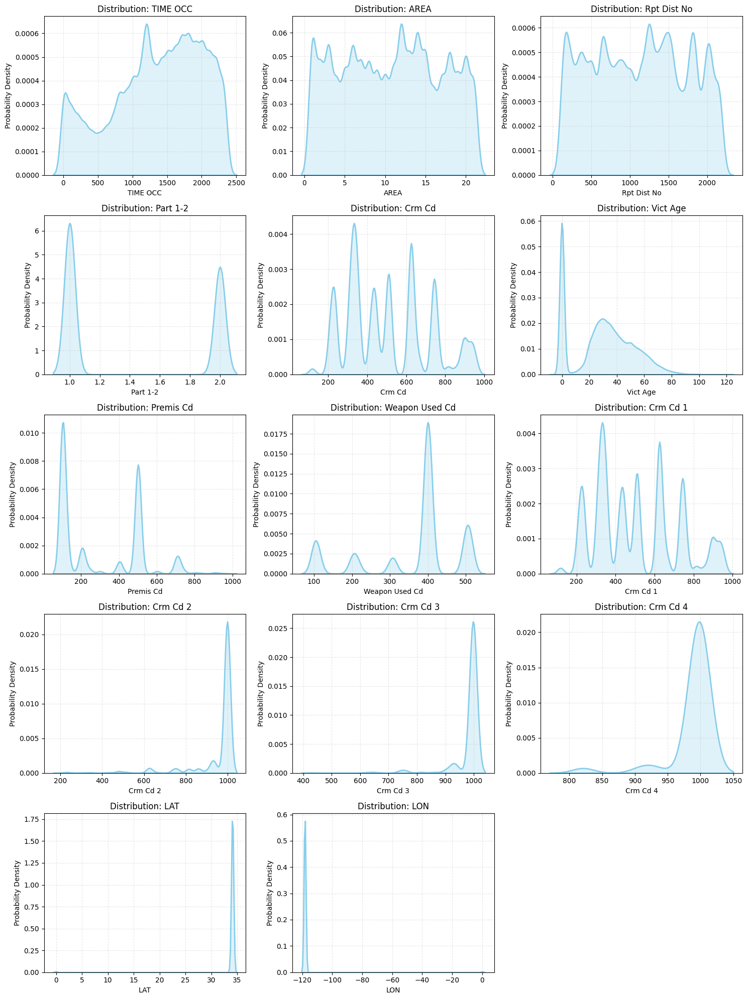

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Identify continuous numerical columns
continuous_cols = d.select_dtypes(include=['float64', 'int64']).columns

# Set up the plot grid
num_cols = len(continuous_cols)
cols = 3
rows = (num_cols + cols - 1) // cols

plt.figure(figsize=(cols * 5, rows * 4))

# Plot individual KDEs for each continuous column
for i, col in enumerate(continuous_cols, 1):
    plt.subplot(rows, cols, i)
    sns.kdeplot(d[col].dropna(), fill=True, color='skyblue', linewidth=2)
    plt.title(f'Distribution: {col}')
    plt.xlabel(col)
    plt.ylabel('Probability Density')
    plt.grid(True, linestyle='--', alpha=0.3)

plt.tight_layout()
plt.show()


ENDING 1ST EDITED AREA

deleting rows more than 70% Nan

In [ ]:
threshold_pct = 0.7
missing_counts = d.isna().sum(axis=1)
d = d[missing_counts / len(d.columns) < threshold_pct]

Time of occurence

In [ ]:
def f(x):
    if (x > 4) and (x <= 8) or (x > 400) and (x <= 800):
        return 'Early Morning'
    elif (x > 8) and (x <= 12 ) or (x > 800) and (x <= 1200 ):
        return 'Morning'
    elif (x > 12) and (x <= 16) or (x > 1200) and (x <= 1600):
        return'Afternoon'
    elif (x > 16) and (x <= 20) or (x > 1600) and (x <= 2000):
        return 'Evening'
    elif (x > 20) and (x <= 24) or (x > 2000) and (x <= 2400):
        return'Night'
    elif (x <= 4) or (x <= 400):
        return'Late Night'

d['hour'] = d['TIME OCC'].apply(f)

In [ ]:
d[['TIME OCC', 'hour']].head(2)

,TIME OCC,hour
0,2130.0,Night
1,1800.0,Evening


Cleaning location column

In [ ]:
def clean_location(location_string):
  # Convert location_string to string to handle potential float values
  location_string = str(location_string)
  parts = location_string.split(' ')
  parts = [part for part in parts if part]
  street_number = parts[0]
  direction = parts[1] if len(parts) > 1 else None
  street_name = ' '.join(parts[2:])
  cleaned_location = f"{street_number} {' '.join([direction, street_name]) if direction else street_name}"
  return cleaned_location

d['LOCATION'] = d['LOCATION'].apply(clean_location)

Merging Area location etc

In [ ]:
d['AREA_LOCATION'] = d.apply(lambda row: ' '.join([str(row['AREA']), str(row['AREA NAME']), str(row['LOCATION'])]), axis=1)

Keeping only male and female victims

In [ ]:
d = d[d['Vict Sex'].isin(['M', 'F'])]

Replaceing missing values

In [ ]:
d['Premis Cd'] = d['Premis Cd'].fillna(0)

<ipython-input-14-afe0a50ace8f>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d['Premis Cd'] = d['Premis Cd'].fillna(0)


Taking a sample

In [ ]:
sample_d_1 = d.sample(10000)
sample_d_1.head(2)

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON,hour,AREA_LOCATION
216314,231510511,06/01/2023 12:00:00 AM,07/26/2021 12:00:00 AM,1200.0,15.0,N Hollywood,1545.0,1.0,341.0,"THEFT-GRAND ($950.01 & OVER)EXCPT,GUNS,FOWL,LI...",0344,81.0,F,W,501.0,SINGLE FAMILY DWELLING,NaN,NaN,IC,Invest Cont,341.0,NaN,NaN,NaN,4900 GENTRY AV,NaN,34.1595,-118.3932,Morning,15.0 N Hollywood 4900 GENTRY AV
120861,200809817,05/22/2020 12:00:00 AM,05/18/2020 12:00:00 AM,300.0,8.0,West LA,829.0,1.0,440.0,THEFT PLAIN - PETTY ($950 & UNDER),0344 0202 1822 1602 0397 1202 1420,75.0,F,W,123.0,PARKING UNDERGROUND/BUILDING,NaN,NaN,IC,Invest Cont,440.0,NaN,NaN,NaN,1200 S BEVERLY GLEN BL,NaN,34.0669,-118.4288,Late Night,8.0 West LA 1200 S BEVERLY GLEN BL


Dropping columns

In [ ]:
imp_sample_d_1 = sample_d_1.drop(['DR_NO', 'Date Rptd','DATE OCC', 'TIME OCC','AREA','Rpt Dist No', 'Part 1-2','Crm Cd Desc',
                                  'Vict Age','Vict Descent', 'Premis Desc', 'Weapon Desc','Weapon Used Cd', 'Status', 'Status Desc', 'Crm Cd 1',
                                  'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4','LOCATION','Cross Street','AREA NAME', 'LAT','LON', 'Mocodes' ],axis = 1)


In [ ]:
imp_sample_d_1.head(2)

,Crm Cd,Vict Sex,Premis Cd,hour,AREA_LOCATION
216314,341.0,F,501.0,Morning,15.0 N Hollywood 4900 GENTRY AV
120861,440.0,F,123.0,Late Night,8.0 West LA 1200 S BEVERLY GLEN BL


Gender Encoding

In [ ]:
#one hot encoding


victim_encoded_df = pd.get_dummies(imp_sample_d_1, columns = ['Vict Sex'], dtype = 'int')

victim_encoded_df = victim_encoded_df.drop(['Crm Cd','Premis Cd','hour','AREA_LOCATION'], axis=1)

victim_encoded_df.head(2)

,Vict Sex_F,Vict Sex_M
216314,1,0
120861,1,0


Hour encoding

In [ ]:
#one hot encoding

hour_encoded_df = pd.get_dummies(imp_sample_d_1, columns = ['hour'], dtype = 'int')

hour_encoded_df = hour_encoded_df.drop(['Crm Cd','Premis Cd','Vict Sex','AREA_LOCATION'], axis=1)

hour_encoded_df.head(2)

,hour_Afternoon,hour_Early Morning,hour_Evening,hour_Late Night,hour_Morning,hour_Night
216314,0,0,0,0,1,0
120861,0,0,0,1,0,0


Area Location encoding

In [ ]:
place_encoded_df = pd.get_dummies(imp_sample_d_1, columns = ['AREA_LOCATION'], dtype = 'int')

place_encoded_df = place_encoded_df.drop(['Crm Cd','Premis Cd','Vict Sex','hour'], axis=1)

place_encoded_df.head(2)

,AREA_LOCATION_1.0 Central 00 GATEWAY PLAZ DR,AREA_LOCATION_1.0 Central 00 GATEWAY PLZ,AREA_LOCATION_1.0 Central 100 E 1ST ST,AREA_LOCATION_1.0 Central 100 E 5TH ST,AREA_LOCATION_1.0 Central 100 E 7TH ST,AREA_LOCATION_1.0 Central 100 E 8TH ST,AREA_LOCATION_1.0 Central 100 E 9TH ST,AREA_LOCATION_1.0 Central 100 E BLOOM ST,AREA_LOCATION_1.0 Central 100 N CENTRAL AV,AREA_LOCATION_1.0 Central 100 N HILL ST,AREA_LOCATION_1.0 Central 100 N JUDGE JOHN AISO ST,AREA_LOCATION_1.0 Central 100 PASEO DE LA,AREA_LOCATION_1.0 Central 100 PASEO DE LA PLAZA,AREA_LOCATION_1.0 Central 100 S FIGUEROA ST,AREA_LOCATION_1.0 Central 100 S HILL ST,AREA_LOCATION_1.0 Central 100 S LOS ANGELES ST,AREA_LOCATION_1.0 Central 100 W 2ND ST,AREA_LOCATION_1.0 Central 100 W 5TH ST,AREA_LOCATION_1.0 Central 100 W 7TH ST,AREA_LOCATION_1.0 Central 100 WINSTON ST,AREA_LOCATION_1.0 Central 1000 MAPLE AV,AREA_LOCATION_1.0 Central 1000 N ALAMEDA ST,AREA_LOCATION_1.0 Central 1000 N VIGNES ST,AREA_LOCATION_1.0 Central 1000 S BROADWAY,AREA_LOCATION_1.0 Central 1000 S FIGUEROA ST,AREA_LOCATION_1.0 Central 1000 S GRAND AV,AREA_LOCATION_1.0 Central 1000 S HILL ST,AREA_LOCATION_1.0 Central 1000 S HOPE ST,AREA_LOCATION_1.0 Central 1000 S OLIVE ST,AREA_LOCATION_1.0 Central 1000 W 8TH ST,AREA_LOCATION_1.0 Central 1100 E 5TH ST,AREA_LOCATION_1.0 Central 1100 S BROADWAY,AREA_LOCATION_1.0 Central 1100 S FIGUEROA ST,AREA_LOCATION_1.0 Central 1100 S FLOWER ST,AREA_LOCATION_1.0 Central 1100 S GRAND AV,AREA_LOCATION_1.0 Central 1100 S SANTEE ST,AREA_LOCATION_1.0 Central 1100 W SUNSET BL,AREA_LOCATION_1.0 Central 11TH,AREA_LOCATION_1.0 Central 11TH ST,AREA_LOCATION_1.0 Central 1200 E 6TH ST,AREA_LOCATION_1.0 Central 1200 INNES AV,AREA_LOCATION_1.0 Central 1200 MAPLE AV,AREA_LOCATION_1.0 Central 1200 N SPRING ST,AREA_LOCATION_1.0 Central 1200 S FIGUEROA ST,AREA_LOCATION_1.0 Central 1200 S GRAND AV,AREA_LOCATION_1.0 Central 1200 S HOPE ST,AREA_LOCATION_1.0 Central 1200 S MAIN ST,AREA_LOCATION_1.0 Central 1200 S OLIVE ST,AREA_LOCATION_1.0 Central 1200 WHOLESALE ST,AREA_LOCATION_1.0 Central 12TH,AREA_LOCATION_1.0 Central 1300 CARDINAL ST,AREA_LOCATION_1.0 Central 1300 CONWAY PL,AREA_LOCATION_1.0 Central 1300 E 6TH ST,AREA_LOCATION_1.0 Central 1300 FACTORY PL,AREA_LOCATION_1.0 Central 1300 S FIGUEROA ST,AREA_LOCATION_1.0 Central 1300 S HOPE ST,AREA_LOCATION_1.0 Central 1300 S MAIN ST,AREA_LOCATION_1.0 Central 1300 S SANTEE ST,AREA_LOCATION_1.0 Central 1300 W SUNSET BL,AREA_LOCATION_1.0 Central 1400 MAPLE AV,AREA_LOCATION_1.0 Central 1400 S FLOWER ST,AREA_LOCATION_1.0 Central 1400 S GRAND AV,AREA_LOCATION_1.0 Central 14TH ST,AREA_LOCATION_1.0 Central 1500 S FLOWER ST,AREA_LOCATION_1.0 Central 1600 S BROADWAY,AREA_LOCATION_1.0 Central 1600 S FLOWER ST,AREA_LOCATION_1.0 Central 1600 S HOPE ST,AREA_LOCATION_1.0 Central 1600 S MAIN ST,AREA_LOCATION_1.0 Central 1700 E 7TH ST,AREA_LOCATION_1.0 Central 1700 NAUD ST,AREA_LOCATION_1.0 Central 1700 S GEORGIA ST,AREA_LOCATION_1.0 Central 1700 S HILL ST,AREA_LOCATION_1.0 Central 17TH,AREA_LOCATION_1.0 Central 1800 S FIGUEROA ST,AREA_LOCATION_1.0 Central 18TH,AREA_LOCATION_1.0 Central 1ST,AREA_LOCATION_1.0 Central 1ST ST,AREA_LOCATION_1.0 Central 200 E 15TH ST,AREA_LOCATION_1.0 Central 200 E 2ND ST,AREA_LOCATION_1.0 Central 200 E 8TH ST,AREA_LOCATION_1.0 Central 200 N LOS ANGELES ST,AREA_LOCATION_1.0 Central 200 N MAIN ST,AREA_LOCATION_1.0 Central 200 S BROADWAY,AREA_LOCATION_1.0 Central 200 S FIGUEROA ST,AREA_LOCATION_1.0 Central 200 S GRAND AV,AREA_LOCATION_1.0 Central 200 S HILL ST,AREA_LOCATION_1.0 Central 200 S LOS ANGELES ST,AREA_LOCATION_1.0 Central 200 S MAIN ST,AREA_LOCATION_1.0 Central 200 S SPRING ST,AREA_LOCATION_1.0 Central 200 W 6TH ST,AREA_LOCATION_1.0 Central 200 W 7TH ST,AREA_LOCATION_1.0 Central 200 W TEMPLE ST,AREA_LOCATION_1.0 Central 2ND,AREA_LOCATION_1.0 Central 2ND ST,AREA_LOCATION_1.0 Central 300 AVERY ST,AREA_LOCATION_1.0 Central 300 CROCKER ST,AREA_LOCATION_1.0 Central 300 E 1ST ST,AREA_LOCATION_1.0 Central 300 E 2ND ST,AREA_LOCA

Keeping only Crime and Premis in main df since others are encoded

In [ ]:
imp_sample_d_1 = imp_sample_d_1.drop(['Vict Sex','hour','AREA_LOCATION'], axis=1)

In [ ]:
imp_sample_d_1.head(2)

,Crm Cd,Premis Cd
216314,341.0,501.0
120861,440.0,123.0


Combining all the encoded dataframes together in a df

In [ ]:
categorical_df = pd.concat([victim_encoded_df,hour_encoded_df,place_encoded_df],axis=1)

Combining the encoded categorical df with main df(codes)

In [ ]:
combined_df = pd.concat([categorical_df, imp_sample_d_1], axis=1)

In [ ]:
combined_df.head(5)


,Vict Sex_F,Vict Sex_M,hour_Afternoon,hour_Early Morning,hour_Evening,hour_Late Night,hour_Morning,hour_Night,AREA_LOCATION_1.0 Central 00 GATEWAY PLAZ DR,AREA_LOCATION_1.0 Central 00 GATEWAY PLZ,AREA_LOCATION_1.0 Central 100 E 1ST ST,AREA_LOCATION_1.0 Central 100 E 5TH ST,AREA_LOCATION_1.0 Central 100 E 7TH ST,AREA_LOCATION_1.0 Central 100 E 8TH ST,AREA_LOCATION_1.0 Central 100 E 9TH ST,AREA_LOCATION_1.0 Central 100 E BLOOM ST,AREA_LOCATION_1.0 Central 100 N CENTRAL AV,AREA_LOCATION_1.0 Central 100 N HILL ST,AREA_LOCATION_1.0 Central 100 N JUDGE JOHN AISO ST,AREA_LOCATION_1.0 Central 100 PASEO DE LA,AREA_LOCATION_1.0 Central 100 PASEO DE LA PLAZA,AREA_LOCATION_1.0 Central 100 S FIGUEROA ST,AREA_LOCATION_1.0 Central 100 S HILL ST,AREA_LOCATION_1.0 Central 100 S LOS ANGELES ST,AREA_LOCATION_1.0 Central 100 W 2ND ST,AREA_LOCATION_1.0 Central 100 W 5TH ST,AREA_LOCATION_1.0 Central 100 W 7TH ST,AREA_LOCATION_1.0 Central 100 WINSTON ST,AREA_LOCATION_1.0 Central 1000 MAPLE AV,AREA_LOCATION_1.0 Central 1000 N ALAMEDA ST,AREA_LOCATION_1.0 Central 1000 N VIGNES ST,AREA_LOCATION_1.0 Central 1000 S BROADWAY,AREA_LOCATION_1.0 Central 1000 S FIGUEROA ST,AREA_LOCATION_1.0 Central 1000 S GRAND AV,AREA_LOCATION_1.0 Central 1000 S HILL ST,AREA_LOCATION_1.0 Central 1000 S HOPE ST,AREA_LOCATION_1.0 Central 1000 S OLIVE ST,AREA_LOCATION_1.0 Central 1000 W 8TH ST,AREA_LOCATION_1.0 Central 1100 E 5TH ST,AREA_LOCATION_1.0 Central 1100 S BROADWAY,AREA_LOCATION_1.0 Central 1100 S FIGUEROA ST,AREA_LOCATION_1.0 Central 1100 S FLOWER ST,AREA_LOCATION_1.0 Central 1100 S GRAND AV,AREA_LOCATION_1.0 Central 1100 S SANTEE ST,AREA_LOCATION_1.0 Central 1100 W SUNSET BL,AREA_LOCATION_1.0 Central 11TH,AREA_LOCATION_1.0 Central 11TH ST,AREA_LOCATION_1.0 Central 1200 E 6TH ST,AREA_LOCATION_1.0 Central 1200 INNES AV,AREA_LOCATION_1.0 Central 1200 MAPLE AV,AREA_LOCATION_1.0 Central 1200 N SPRING ST,AREA_LOCATION_1.0 Central 1200 S FIGUEROA ST,AREA_LOCATION_1.0 Central 1200 S GRAND AV,AREA_LOCATION_1.0 Central 1200 S HOPE ST,AREA_LOCATION_1.0 Central 1200 S MAIN ST,AREA_LOCATION_1.0 Central 1200 S OLIVE ST,AREA_LOCATION_1.0 Central 1200 WHOLESALE ST,AREA_LOCATION_1.0 Central 12TH,AREA_LOCATION_1.0 Central 1300 CARDINAL ST,AREA_LOCATION_1.0 Central 1300 CONWAY PL,AREA_LOCATION_1.0 Central 1300 E 6TH ST,AREA_LOCATION_1.0 Central 1300 FACTORY PL,AREA_LOCATION_1.0 Central 1300 S FIGUEROA ST,AREA_LOCATION_1.0 Central 1300 S HOPE ST,AREA_LOCATION_1.0 Central 1300 S MAIN ST,AREA_LOCATION_1.0 Central 1300 S SANTEE ST,AREA_LOCATION_1.0 Central 1300 W SUNSET BL,AREA_LOCATION_1.0 Central 1400 MAPLE AV,AREA_LOCATION_1.0 Central 1400 S FLOWER ST,AREA_LOCATION_1.0 Central 1400 S GRAND AV,AREA_LOCATION_1.0 Central 14TH ST,AREA_LOCATION_1.0 Central 1500 S FLOWER ST,AREA_LOCATION_1.0 Central 1600 S BROADWAY,AREA_LOCATION_1.0 Central 1600 S FLOWER ST,AREA_LOCATION_1.0 Central 1600 S HOPE ST,AREA_LOCATION_1.0 Central 1600 S MAIN ST,AREA_LOCATION_1.0 Central 1700 E 7TH ST,AREA_LOCATION_1.0 Central 1700 NAUD ST,AREA_LOCATION_1.0 Central 1700 S GEORGIA ST,AREA_LOCATION_1.0 Central 1700 S HILL ST,AREA_LOCATION_1.0 Central 17TH,AREA_LOCATION_1.0 Central 1800 S FIGUEROA ST,AREA_LOCATION_1.0 Central 18TH,AREA_LOCATION_1.0 Central 1ST,AREA_LOCATION_1.0 Central 1ST ST,AREA_LOCATION_1.0 Central 200 E 15TH ST,AREA_LOCATION_1.0 Central 200 E 2ND ST,AREA_LOCATION_1.0 Central 200 E 8TH ST,AREA_LOCATION_1.0 Central 200 N LOS ANGELES ST,AREA_LOCATION_1.0 Central 200 N MAIN ST,AREA_LOCATION_1.0 Central 200 S BROADWAY,AREA_LOCATION_1.0 Central 200 S FIGUEROA ST,AREA_LOCATION_1.0 Central 200 S GRAND AV,AREA_LOCATION_1.0 Central 200 S HILL ST,AREA_LOCATION_1.0 Central 200 S LOS ANGELES ST,AREA_LOCATION_1.0 Central 200 S MAIN ST,AREA_LOCATION_1.0 Central 200 S SPRING ST,AREA_LOCATION_1.0 Central 200 W 6TH ST,AREA_LOCATION_1.0 Central 200 W 7TH ST,AREA_LOCATION_1.0 Central 200 W TEMPLE ST,AREA_LOCATION_1.0 Central 2ND,AREA_LOCATION_1.0 Central 2ND ST,AREA_LOCATION_1.0 Central 300 AVERY ST,AREA_LOCATION_1.0 C

In [ ]:
combined_df.columns.size

7616

ORDER 5

New Table for Results

In [ ]:
SilhouetteTable5 = pd.DataFrame()
DaviesBouldinTable5 = pd.DataFrame()

Dropping columns

In [ ]:
imp_sample_d_1 = sample_d_1.drop(['DR_NO', 'Date Rptd','DATE OCC', 'TIME OCC','AREA','Rpt Dist No', 'Part 1-2','Crm Cd Desc',
                                  'Vict Age','Vict Descent', 'Premis Desc', 'Weapon Desc','Weapon Used Cd', 'Status', 'Status Desc', 'Crm Cd 1',
                                  'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4','LOCATION','Cross Street','AREA NAME', 'LAT','LON', 'Mocodes' ],axis = 1)


Keeping only Crime and Premis in main df since others are encoded

In [ ]:
imp_sample_d_1 = imp_sample_d_1.drop(['Vict Sex','hour','AREA_LOCATION'], axis=1)

KMEANS

1. Gender Area

In [ ]:
ga = pd.concat([victim_encoded_df,place_encoded_df ],axis = 1)

In [ ]:
ga.columns.size

7608

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb51 = sc.fit_transform(ga)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb51)

principalDf51 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from matplotlib.pyplot import plot
from sklearn.cluster import KMeans

k=10
kmeans = KMeans(n_clusters=4)
kmeans.fit(principalDf51)
clusters = kmeans.labels_
centroids = kmeans.cluster_centers_

imp_sample_d_1['cluster1_k'] = kmeans.labels_

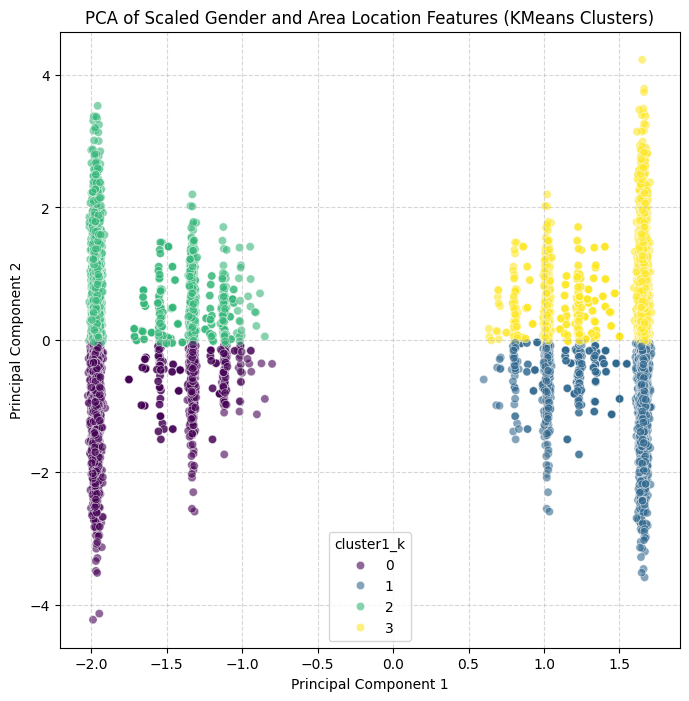

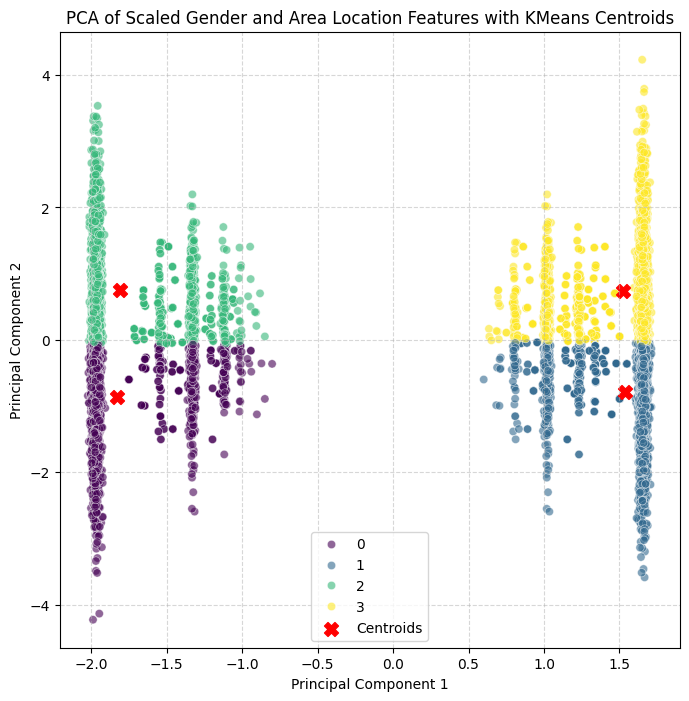

In [ ]:


# # Analyze the number of crimes per hour
# plt.figure(figsize=(10, 6))
# sns.countplot(x='hour', data=d, order=d['hour'].value_counts().index, palette='viridis')
# plt.title('Number of Crimes by Time of Day')
# plt.xlabel('Time of Day')
# plt.ylabel('Number of Crimes')
# plt.xticks(rotation=45, ha='right')
# plt.tight_layout()
# plt.show()

# # Analyze the distribution of crime codes
# plt.figure(figsize=(14, 7))
# top_n = 15
# sns.countplot(y='Crm Cd', data=d, order=d['Crm Cd'].value_counts().iloc[:top_n].index, palette='magma')
# plt.title(f'Top {top_n} Crime Codes')
# plt.xlabel('Number of Crimes')
# plt.ylabel('Crime Code')
# plt.tight_layout()
# plt.show()

# # Analyze the distribution of premises codes
# plt.figure(figsize=(14, 7))
# top_n = 15
# sns.countplot(y='Premis Cd', data=d, order=d['Premis Cd'].astype(int).value_counts().iloc[:top_n].index, palette='cividis')
# plt.title(f'Top {top_n} Premises Codes')
# plt.xlabel('Number of Crimes')
# plt.ylabel('Premises Code')
# plt.tight_layout()
# plt.show()

# # Analyze the distribution of victim sex
# plt.figure(figsize=(6, 4))
# sns.countplot(x='Vict Sex', data=d, palette='plasma')
# plt.title('Distribution of Victim Sex')
# plt.xlabel('Victim Sex')
# plt.ylabel('Number of Crimes')
# plt.tight_layout()
# plt.show()

# Plot the PCA results for KMeans
plt.figure(figsize=(8, 8))
sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster1_k', data=principalDf51.assign(cluster1_k=clusters),
                palette='viridis', legend='full', alpha=0.6)
plt.title('PCA of Scaled Gender and Area Location Features (KMeans Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Add centroids to the PCA plot
plt.figure(figsize=(8, 8))
sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster1_k', data=principalDf51.assign(cluster1_k=clusters),
                palette='viridis', legend='full', alpha=0.6)
plt.scatter(centroids[:, 0], centroids[:, 1], marker='X', s=100, c='red', label='Centroids')
plt.title('PCA of Scaled Gender and Area Location Features with KMeans Centroids')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

2. Gender Area Premise

In [ ]:
imp_sample_d_11 = imp_sample_d_1.drop(['Crm Cd'],axis = 1)
#imp_sample_d_11.head(1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb52 = sc.fit_transform(imp_sample_d_11)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb52)

principalDf52 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from matplotlib.pyplot import plot
from sklearn.cluster import KMeans

k=10
kmeans = KMeans(n_clusters=4)
kmeans.fit(principalDf52)
clusters = kmeans.labels_
centroids = kmeans.cluster_centers_

imp_sample_d_1['cluster2_k'] = kmeans.labels_

3. Gender Area Premise Hour


In [ ]:
imp_sample_d_12 = imp_sample_d_1.drop(['Crm Cd','Premis Cd','cluster1_k'],axis = 1)
#imp_sample_d_12.head(1)

In [ ]:
gaph = pd.concat([hour_encoded_df, imp_sample_d_12],axis = 1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb53 = sc.fit_transform(gaph)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb53)

principalDf53 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from matplotlib.pyplot import plot
from sklearn.cluster import KMeans

k=10
kmeans = KMeans(n_clusters=4)
kmeans.fit(principalDf53)
clusters = kmeans.labels_
centroids = kmeans.cluster_centers_

imp_sample_d_1['cluster3_k'] = kmeans.labels_

4. Gender Area Premise Hour Crime

In [ ]:
imp_sample_d_13 = imp_sample_d_1.drop(['cluster2_k','Premis Cd','cluster1_k'],axis = 1)
imp_sample_d_13.head(1)

,Crm Cd,cluster3_k
216314,341.0,1


FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb54 = sc.fit_transform(imp_sample_d_13)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb54)

principalDf54 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from matplotlib.pyplot import plot
from sklearn.cluster import KMeans

k=10
kmeans = KMeans(n_clusters=4)
kmeans.fit(principalDf54)
clusters = kmeans.labels_
centroids = kmeans.cluster_centers_

imp_sample_d_1['cluster4_k'] = kmeans.labels_

Silhouette Score

In [ ]:
from sklearn.metrics import silhouette_score

SilhouetteTable5['KMEAN'] =  [silhouette_score(principalDf54,imp_sample_d_1['cluster4_k'] )]

Davies Bouldin Score

In [ ]:
from sklearn.metrics import davies_bouldin_score
DaviesBouldinTable5['KMEAN'] =  [davies_bouldin_score(principalDf54, imp_sample_d_1['cluster4_k'])]

# Updated Plots

<ipython-input-51-22d3e8ca0ac9>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='hour', data=d, order=['Late Night', 'Early Morning', 'Morning', 'Afternoon', 'Evening', 'Night'], palette='viridis')


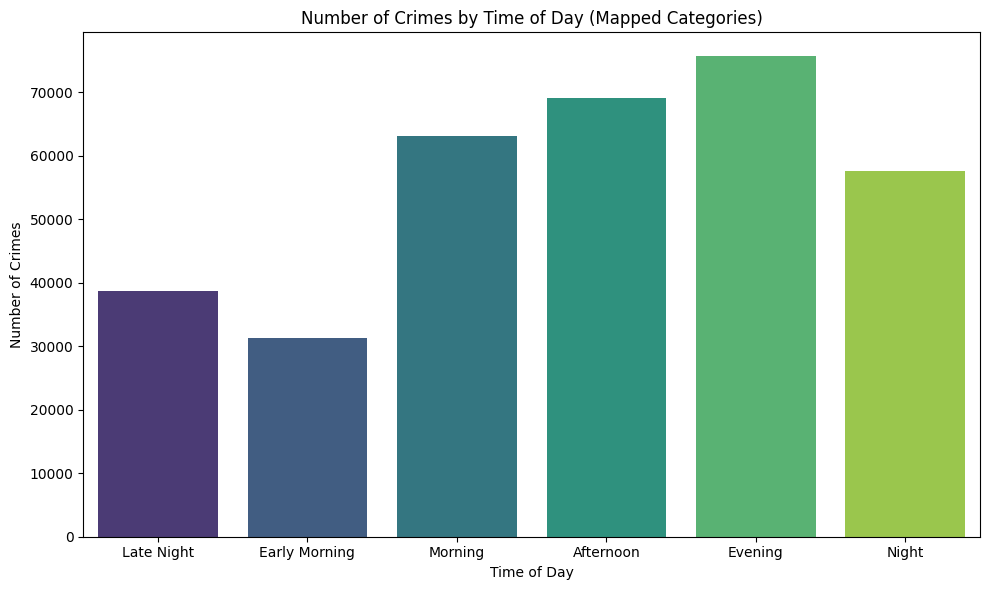

<ipython-input-51-22d3e8ca0ac9>:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(y='Crm Cd', data=sample_d_1, order=sample_d_1['Crm Cd'].value_counts().iloc[:top_n_sample].index, palette='magma')


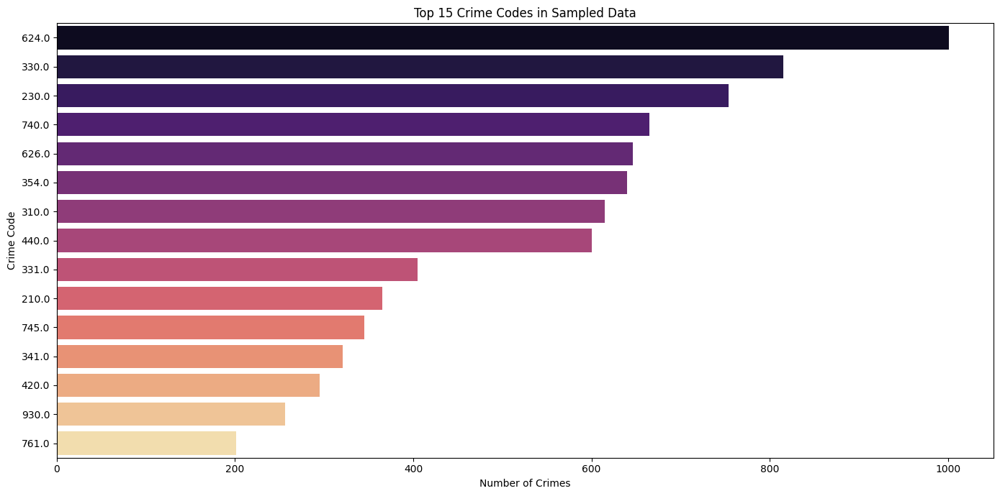

<ipython-input-51-22d3e8ca0ac9>:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(y='Premis Cd', data=sample_d_1, order=sample_d_1['Premis Cd'].astype(int).value_counts().iloc[:top_n_sample_premis].index, palette='cividis')


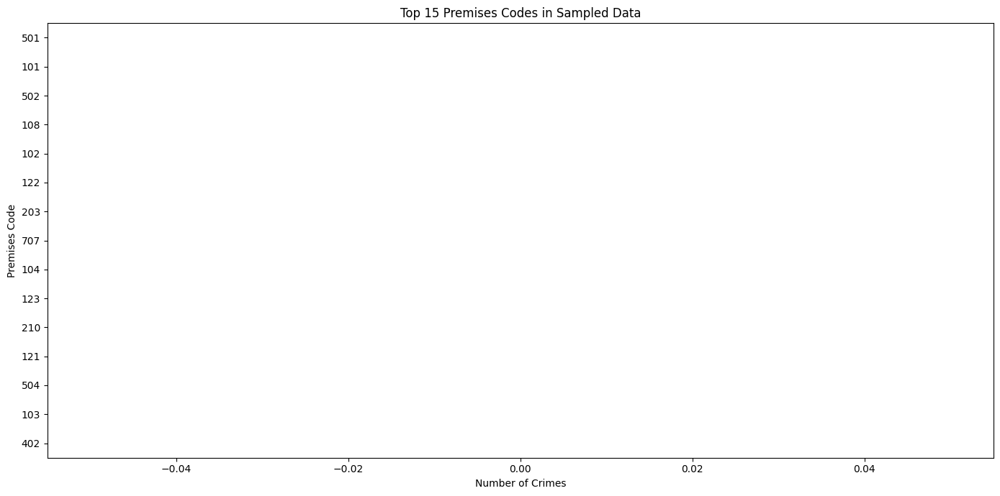

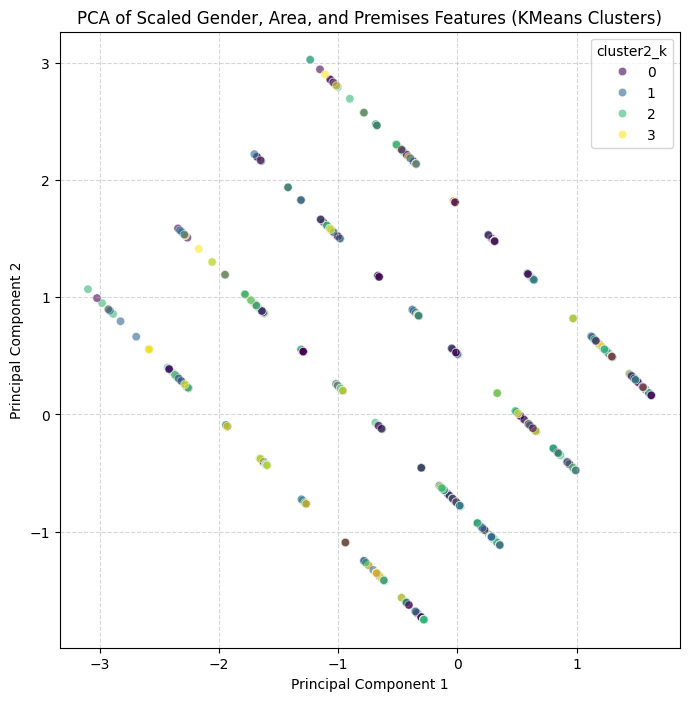

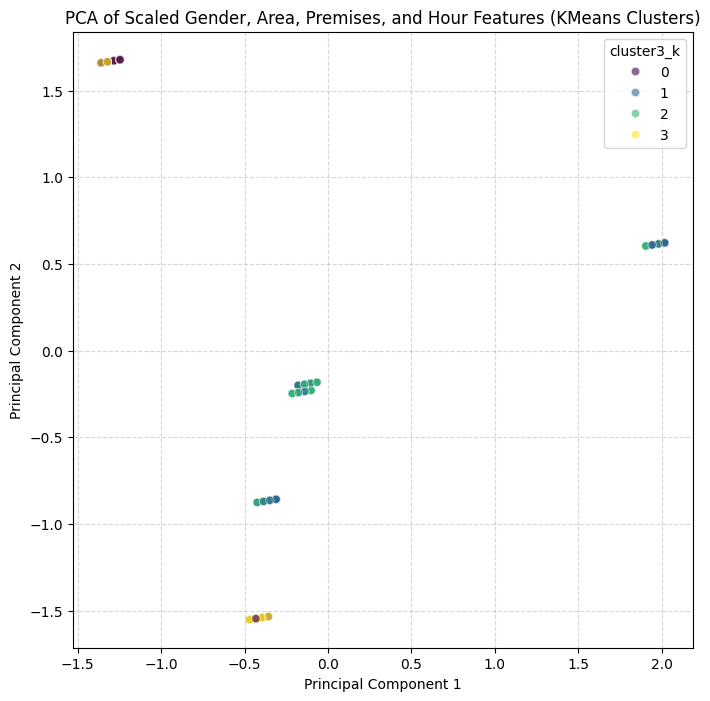

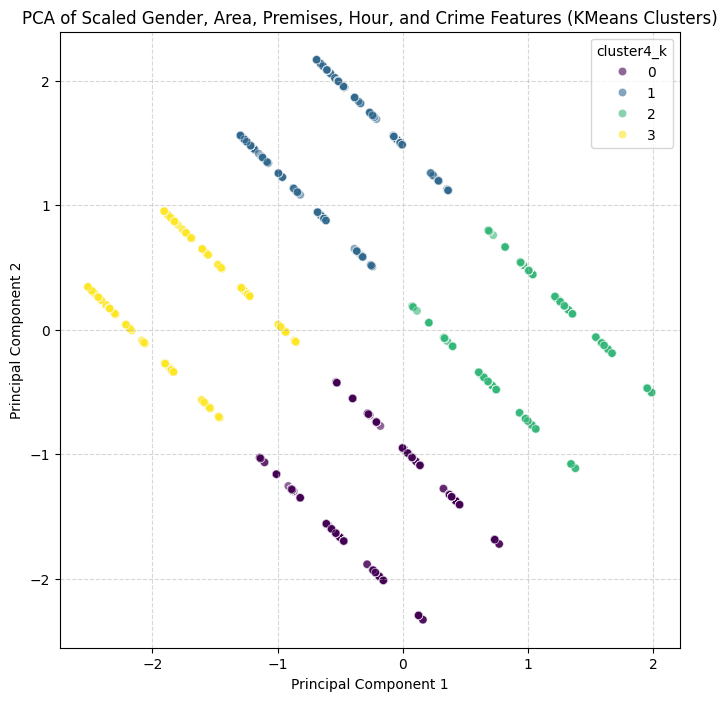

<ipython-input-51-22d3e8ca0ac9>:67: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Metric', y='Score', data=results_df, palette='tab10')


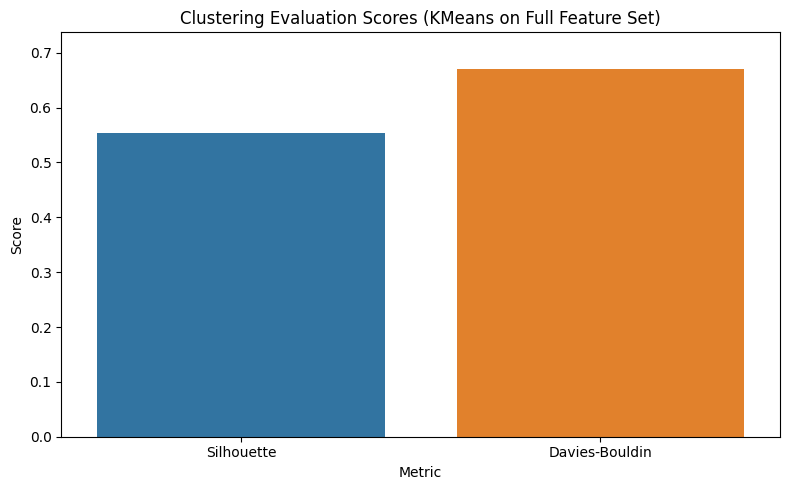

In [ ]:
# Analyze the distribution of the 'hour' column after mapping
plt.figure(figsize=(10, 6))
sns.countplot(x='hour', data=d, order=['Late Night', 'Early Morning', 'Morning', 'Afternoon', 'Evening', 'Night'], palette='viridis')
plt.title('Number of Crimes by Time of Day (Mapped Categories)')
plt.xlabel('Time of Day')
plt.ylabel('Number of Crimes')
plt.tight_layout()
plt.show()

# Analyze the distribution of crime codes in the sampled data
plt.figure(figsize=(14, 7))
top_n_sample = 15
sns.countplot(y='Crm Cd', data=sample_d_1, order=sample_d_1['Crm Cd'].value_counts().iloc[:top_n_sample].index, palette='magma')
plt.title(f'Top {top_n_sample} Crime Codes in Sampled Data')
plt.xlabel('Number of Crimes')
plt.ylabel('Crime Code')
plt.tight_layout()
plt.show()

# Analyze the distribution of premises codes in the sampled data
plt.figure(figsize=(14, 7))
top_n_sample_premis = 15
sns.countplot(y='Premis Cd', data=sample_d_1, order=sample_d_1['Premis Cd'].astype(int).value_counts().iloc[:top_n_sample_premis].index, palette='cividis')
plt.title(f'Top {top_n_sample_premis} Premises Codes in Sampled Data')
plt.xlabel('Number of Crimes')
plt.ylabel('Premises Code')
plt.tight_layout()
plt.show()

# Plot the PCA results for KMeans on Gender, Area, and Premises features
plt.figure(figsize=(8, 8))
sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster2_k', data=principalDf52.assign(cluster2_k=clusters),
                palette='viridis', legend='full', alpha=0.6)
plt.title('PCA of Scaled Gender, Area, and Premises Features (KMeans Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Plot the PCA results for KMeans on Gender, Area, Premises, and Hour features
plt.figure(figsize=(8, 8))
sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster3_k', data=principalDf53.assign(cluster3_k=clusters),
                palette='viridis', legend='full', alpha=0.6)
plt.title('PCA of Scaled Gender, Area, Premises, and Hour Features (KMeans Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Plot the PCA results for KMeans on Gender, Area, Premises, Hour, and Crime features
plt.figure(figsize=(8, 8))
sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster4_k', data=principalDf54.assign(cluster4_k=clusters),
                palette='viridis', legend='full', alpha=0.6)
plt.title('PCA of Scaled Gender, Area, Premises, Hour, and Crime Features (KMeans Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Visualize Silhouette and Davies-Bouldin Scores
results_df = pd.DataFrame({
    'Metric': ['Silhouette', 'Davies-Bouldin'],
    'Score': [SilhouetteTable5['KMEAN'].iloc[0], DaviesBouldinTable5['KMEAN'].iloc[0]]
})

plt.figure(figsize=(8, 5))
sns.barplot(x='Metric', y='Score', data=results_df, palette='tab10')
plt.title('Clustering Evaluation Scores (KMeans on Full Feature Set)')
plt.ylabel('Score')
plt.ylim(0, max(results_df['Score']) * 1.1) # Adjust y-limit for better visualization
plt.tight_layout()
plt.show()

DBSCAN

Dropping columns

In [ ]:
imp_sample_d_1 = sample_d_1.drop(['DR_NO', 'Date Rptd','DATE OCC', 'TIME OCC','AREA','Rpt Dist No', 'Part 1-2','Crm Cd Desc',
                                  'Vict Age','Vict Descent', 'Premis Desc', 'Weapon Desc','Weapon Used Cd', 'Status', 'Status Desc', 'Crm Cd 1',
                                  'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4','LOCATION','Cross Street','AREA NAME', 'LAT','LON', 'Mocodes' ],axis = 1)


Keeping only Crime and Premis in main df since others are encoded

In [ ]:
imp_sample_d_1 = imp_sample_d_1.drop(['Vict Sex','hour','AREA_LOCATION'], axis=1)

1. Gender Area

In [ ]:
ga = pd.concat([victim_encoded_df,place_encoded_df ],axis = 1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb51 = sc.fit_transform(ga)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb51)

principalDf51 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import DBSCAN

db = DBSCAN(eps=0.1, min_samples=4).fit(principalDf51)
labels = db.labels_

n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

# print('Estimated number of clusters: %d' % n_clusters_)
# print('Estimated number of noise points: %d' % n_noise_)

imp_sample_d_1['cluster1_d']= labels

2. Gender Area Premise

In [ ]:
imp_sample_d_11 = imp_sample_d_1.drop(['Crm Cd'],axis = 1)
#imp_sample_d_11.head(1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb52 = sc.fit_transform(imp_sample_d_11)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb52)

principalDf52 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import DBSCAN

db = DBSCAN(eps=0.1, min_samples=4).fit(principalDf52)
labels = db.labels_

n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

# print('Estimated number of clusters: %d' % n_clusters_)
# print('Estimated number of noise points: %d' % n_noise_)

imp_sample_d_1['cluster2_d']= labels

3. Gender Area Premise Hour


In [ ]:
imp_sample_d_12 = imp_sample_d_1.drop(['Crm Cd','Premis Cd','cluster1_d'],axis = 1)
#imp_sample_d_12.head(1)

In [ ]:
gaph = pd.concat([hour_encoded_df, imp_sample_d_12],axis = 1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb53 = sc.fit_transform(gaph)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb53)

principalDf53 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import DBSCAN

db = DBSCAN(eps=0.1, min_samples=4).fit(principalDf53)
labels = db.labels_

n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

# print('Estimated number of clusters: %d' % n_clusters_)
# print('Estimated number of noise points: %d' % n_noise_)

imp_sample_d_1['cluster3_d']= labels

4. Gender Area Premise Hour Crime

In [ ]:
imp_sample_d_13 = imp_sample_d_1.drop(['cluster2_d','Premis Cd','cluster1_d'],axis = 1)
imp_sample_d_13.head(1)

,Crm Cd,cluster3_d
216314,341.0,0


FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb54 = sc.fit_transform(imp_sample_d_13)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb54)

principalDf54 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import DBSCAN

db = DBSCAN(eps=0.1, min_samples=4).fit(principalDf54)
labels = db.labels_

n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)

imp_sample_d_1['cluster4_d']= labels

Estimated number of clusters: 44
Estimated number of noise points: 0


Silhouette Score

In [ ]:
from sklearn.metrics import silhouette_score

SilhouetteTable5['DBSCAN'] =  [silhouette_score(principalDf54,imp_sample_d_1['cluster4_d'] )]

Davies Bouldin Score

In [ ]:
from sklearn.metrics import davies_bouldin_score
DaviesBouldinTable5['DBSCAN'] =  [davies_bouldin_score(principalDf54, imp_sample_d_1['cluster4_d'])]

# Updated Plots

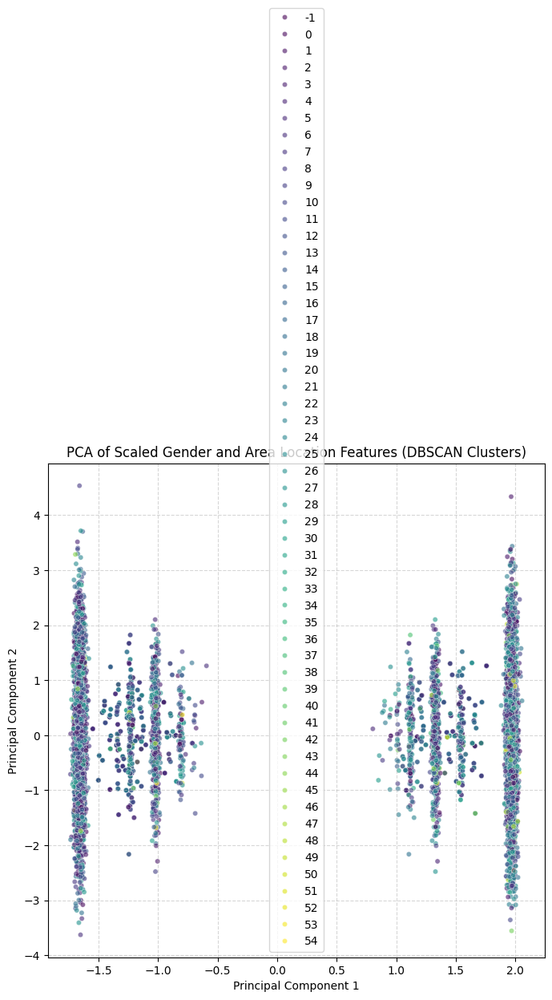

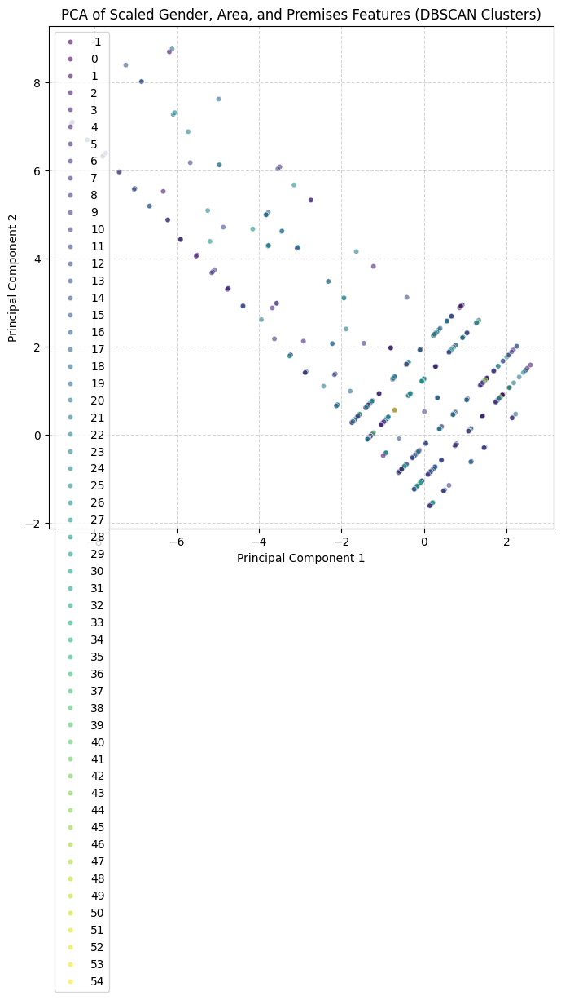

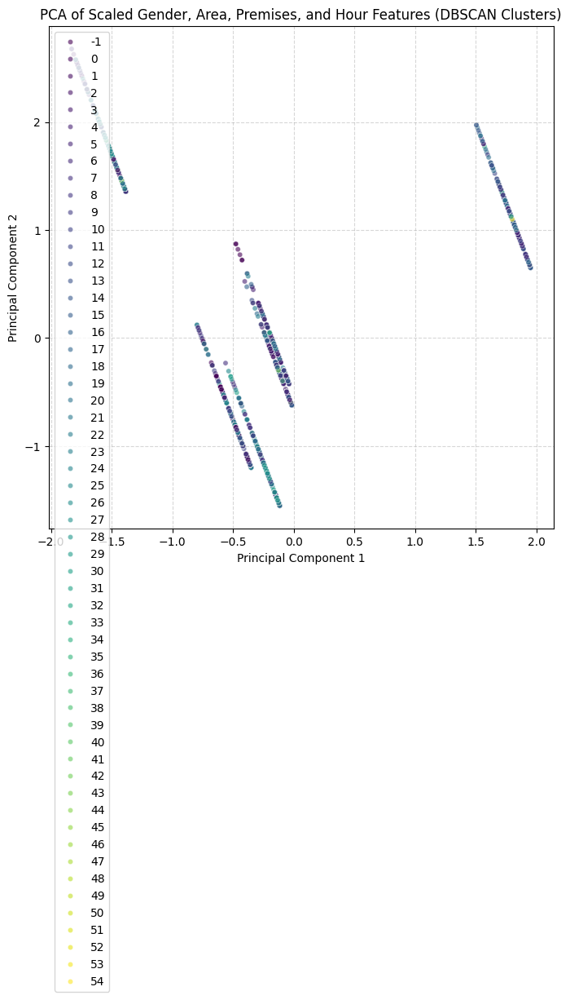

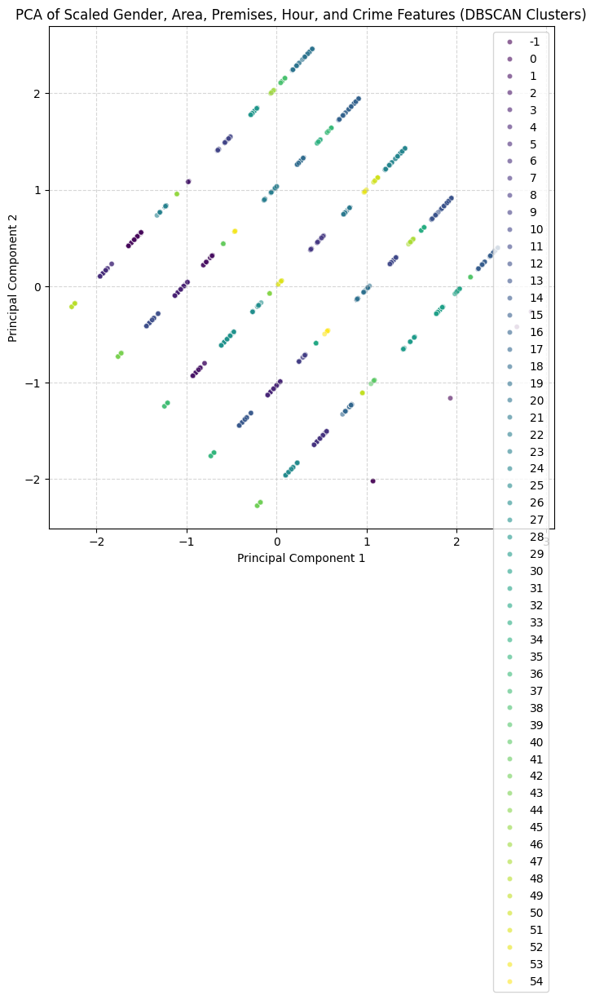

<ipython-input-73-30685d1f0654>:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=cluster_counts_dbscan.index, y=cluster_counts_dbscan.values, palette='viridis')


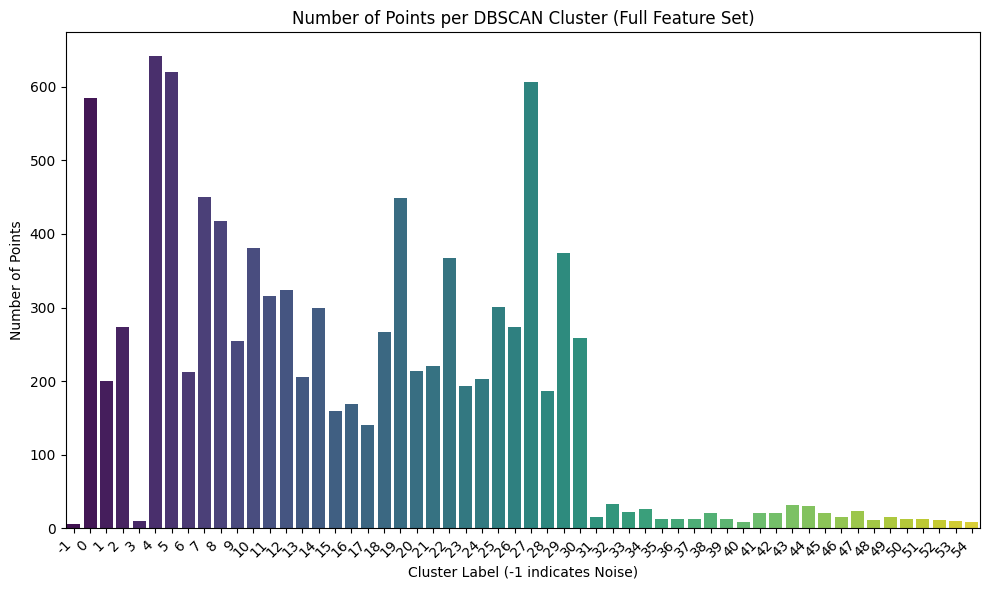

In [ ]:

# Plot the PCA results for DBSCAN on Gender and Area Location features
# Use the 'labels' variable directly from the first DBSCAN algorithm execution
plt.figure(figsize=(8, 8))
# Ensure that the 'labels' variable from the first DBSCAN run is available here.
# If not, you might need to re-run that specific DBSCAN cell or store the labels in a persistent variable.
# Assuming 'labels' from the first DBSCAN run (cells 63-67) is the variable holding the cluster assignments for principalDf51
sns.scatterplot(x='principal component 1', y='principal component 2', hue=labels, data=principalDf51,
                palette='viridis', legend='full', alpha=0.6, s=20)
plt.title('PCA of Scaled Gender and Area Location Features (DBSCAN Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Plot the PCA results for DBSCAN on Gender, Area, and Premises features
# Assuming 'labels' from the second DBSCAN run (cells 72-76) is available
plt.figure(figsize=(8, 8))
sns.scatterplot(x='principal component 1', y='principal component 2', hue=labels, data=principalDf52,
                palette='viridis', legend='full', alpha=0.6, s=20)
plt.title('PCA of Scaled Gender, Area, and Premises Features (DBSCAN Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Plot the PCA results for DBSCAN on Gender, Area, Premises, and Hour features
# Assuming 'labels' from the third DBSCAN run (cells 81-85) is available
plt.figure(figsize=(8, 8))
sns.scatterplot(x='principal component 1', y='principal component 2', hue=labels, data=principalDf53,
                palette='viridis', legend='full', alpha=0.6, s=20)
plt.title('PCA of Scaled Gender, Area, Premises, and Hour Features (DBSCAN Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Plot the PCA results for DBSCAN on Gender, Area, Premises, Hour, and Crime features
# Assuming 'labels' from the fourth DBSCAN run (cells 90-94) is available
plt.figure(figsize=(8, 8))
sns.scatterplot(x='principal component 1', y='principal component 2', hue=labels, data=principalDf54,
                palette='viridis', legend='full', alpha=0.6, s=20)
plt.title('PCA of Scaled Gender, Area, Premises, Hour, and Crime Features (DBSCAN Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Analyze the number of points in each DBSCAN cluster (for the full feature set)
# Assuming 'labels' from the fourth DBSCAN run (cells 90-94) is available and represents the full feature set clusters
cluster_counts_dbscan = pd.Series(labels).value_counts().sort_index()
plt.figure(figsize=(10, 6))
sns.barplot(x=cluster_counts_dbscan.index, y=cluster_counts_dbscan.values, palette='viridis')
plt.title('Number of Points per DBSCAN Cluster (Full Feature Set)')
plt.xlabel('Cluster Label (-1 indicates Noise)')
plt.ylabel('Number of Points')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [ ]:

n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print(f'Estimated number of clusters found by DBSCAN: {n_clusters_}')

Estimated number of clusters found by DBSCAN: 4


HIERARCHICAL AGGLOMERATIVE

Dropping columns

In [ ]:
imp_sample_d_1 = sample_d_1.drop(['DR_NO', 'Date Rptd','DATE OCC', 'TIME OCC','AREA','Rpt Dist No', 'Part 1-2','Crm Cd Desc',
                                  'Vict Age','Vict Descent', 'Premis Desc', 'Weapon Desc','Weapon Used Cd', 'Status', 'Status Desc', 'Crm Cd 1',
                                  'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4','LOCATION','Cross Street','AREA NAME', 'LAT','LON', 'Mocodes' ],axis = 1)


Keeping only Crime and Premis in main df since others are encoded

In [ ]:
imp_sample_d_1 = imp_sample_d_1.drop(['Vict Sex','hour','AREA_LOCATION'], axis=1)

1. Gender Area

In [ ]:
ga = pd.concat([victim_encoded_df,place_encoded_df ],axis = 1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb51 = sc.fit_transform(ga)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb51)

principalDf51 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
import pandas as pd
from sklearn.cluster import AgglomerativeClustering

model = AgglomerativeClustering(n_clusters=4, linkage='average')

model.fit(principalDf51)

imp_sample_d_1['cluster1_h'] = model.labels_

2. Gender Area Premise

In [ ]:
imp_sample_d_11 = imp_sample_d_1.drop(['Crm Cd'],axis = 1)
#imp_sample_d_11.head(1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb52 = sc.fit_transform(imp_sample_d_11)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb52)

principalDf52 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
import pandas as pd
from sklearn.cluster import AgglomerativeClustering

model = AgglomerativeClustering(n_clusters=4, linkage='average')

model.fit(principalDf52)

imp_sample_d_1['cluster2_h'] = model.labels_

3. Gender Area Premise Hour


In [ ]:
imp_sample_d_12 = imp_sample_d_1.drop(['Crm Cd','Premis Cd','cluster1_h'],axis = 1)
#imp_sample_d_12.head(1)

In [ ]:
gaph = pd.concat([hour_encoded_df, imp_sample_d_12],axis = 1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb53 = sc.fit_transform(gaph)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb53)

principalDf53 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
import pandas as pd
from sklearn.cluster import AgglomerativeClustering

model = AgglomerativeClustering(n_clusters=4, linkage='average')

model.fit(principalDf53)

imp_sample_d_1['cluster3_h'] = model.labels_

4. Gender Area Premise Hour Crime

In [ ]:
imp_sample_d_13 = imp_sample_d_1.drop(['cluster2_h','Premis Cd','cluster1_h'],axis = 1)
imp_sample_d_13.head(1)

,Crm Cd,cluster3_h
216314,341.0,1


FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb54 = sc.fit_transform(imp_sample_d_13)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb54)

principalDf54 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
import pandas as pd
from sklearn.cluster import AgglomerativeClustering

model = AgglomerativeClustering(n_clusters=4, linkage='average')

model.fit(principalDf54)

imp_sample_d_1['cluster4_h'] = model.labels_

Silhouette Score

In [ ]:
from sklearn.metrics import silhouette_score

SilhouetteTable5['HIERARCHICAL_AGGLO_AVE'] =  [silhouette_score(principalDf54,imp_sample_d_1['cluster4_h'] )]

Davies Bouldin Score

In [ ]:
from sklearn.metrics import davies_bouldin_score
DaviesBouldinTable5['HIERARCHICAL_AGGLO_AVE'] =  [davies_bouldin_score(principalDf54, imp_sample_d_1['cluster4_h'])]

# UPDATED PLOTS

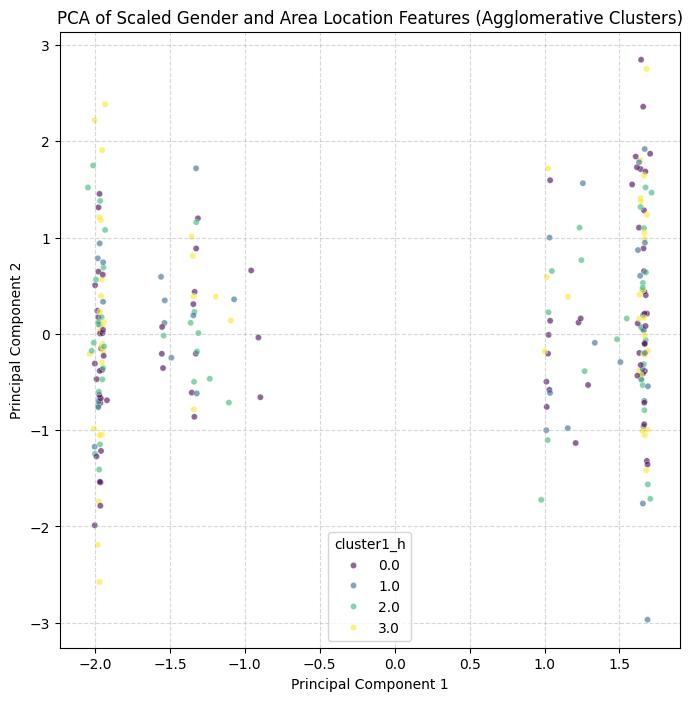

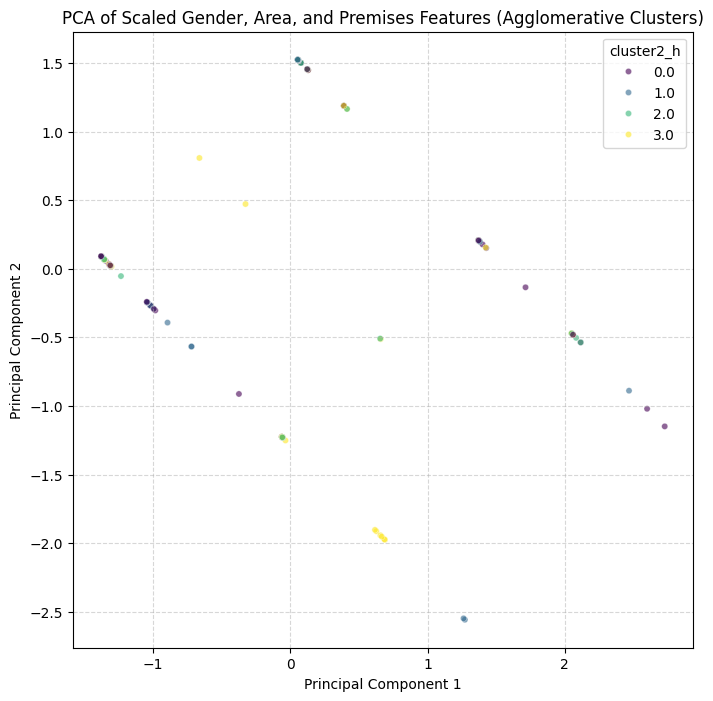

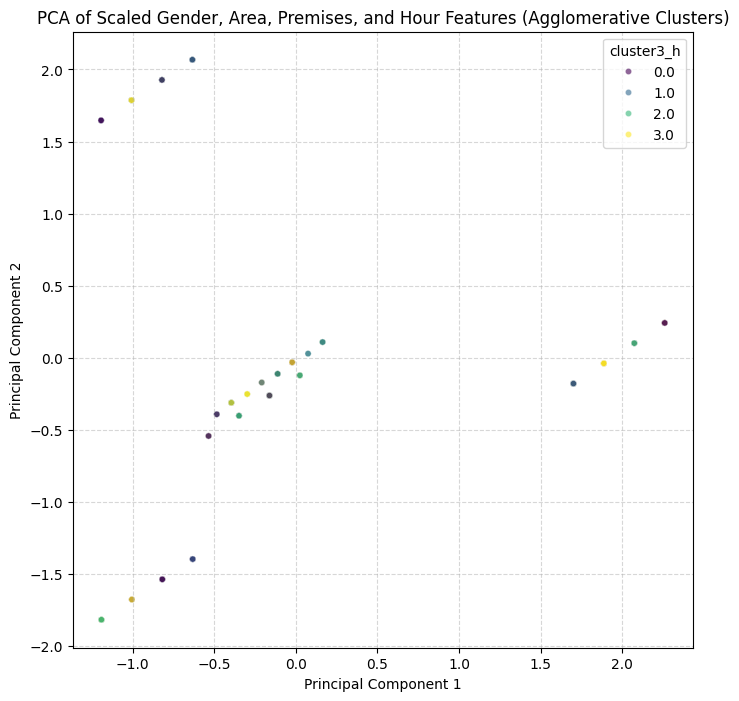

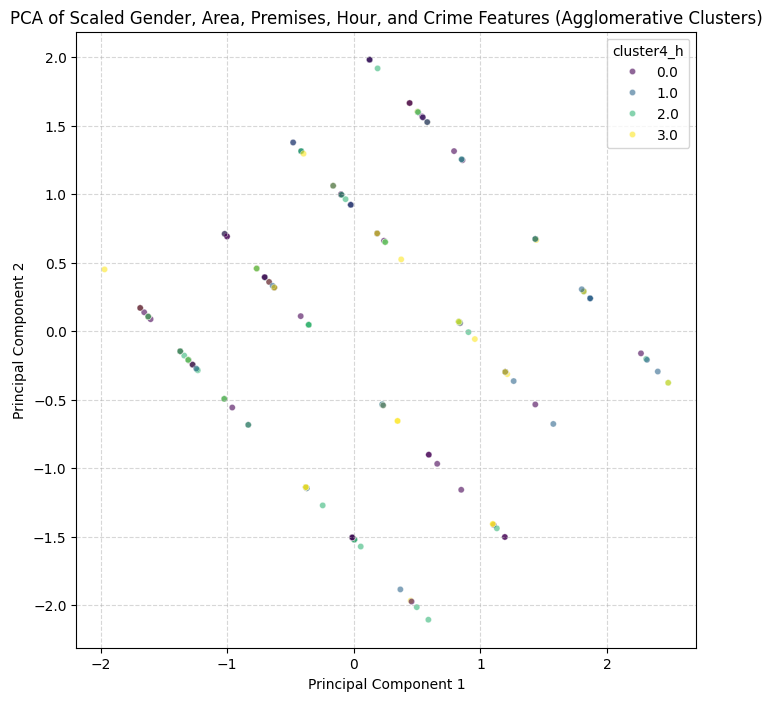

<ipython-input-95-96e8e6df9772>:69: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=cluster_counts_agglo.index, y=cluster_counts_agglo.values, palette='viridis')


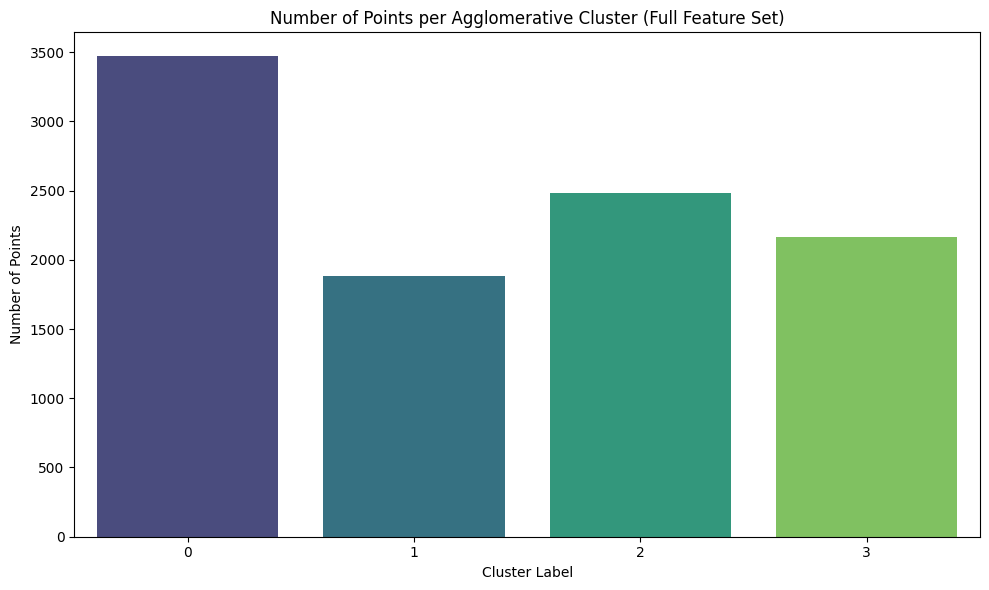

<ipython-input-95-96e8e6df9772>:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Metric', y='Score', data=results_df_agglo, palette='tab10')


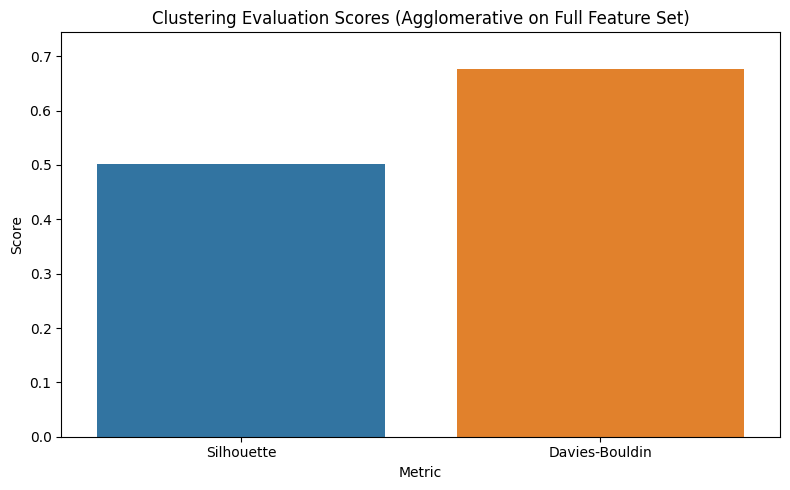

In [ ]:
# Plot the PCA results for Agglomerative Clustering on Gender and Area Location features
# Assign cluster labels to the original sample dataframe
imp_sample_d_1['cluster1_h'] = model.labels_ # Make sure this line is executed after fitting the model on principalDf51

plt.figure(figsize=(8, 8))
# Create a temporary DataFrame for plotting that includes PCA components and cluster labels
plot_df51_h = principalDf51.copy()
plot_df51_h['cluster1_h'] = imp_sample_d_1['cluster1_h']

sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster1_h', data=plot_df51_h,
                palette='viridis', legend='full', alpha=0.6, s=20)
plt.title('PCA of Scaled Gender and Area Location Features (Agglomerative Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Plot the PCA results for Agglomerative Clustering on Gender, Area, and Premises features
# Assuming the model for principalDf52 has been fitted and 'cluster2_h' is assigned
# Assign cluster labels to the original sample dataframe
imp_sample_d_1['cluster2_h'] = model.labels_ # Make sure this line is executed after fitting the model on principalDf52

plt.figure(figsize=(8, 8))
plot_df52_h = principalDf52.copy()
plot_df52_h['cluster2_h'] = imp_sample_d_1['cluster2_h']
sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster2_h', data=plot_df52_h,
                palette='viridis', legend='full', alpha=0.6, s=20)
plt.title('PCA of Scaled Gender, Area, and Premises Features (Agglomerative Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Plot the PCA results for Agglomerative Clustering on Gender, Area, Premises, and Hour features
# Assuming the model for principalDf53 has been fitted and 'cluster3_h' is assigned
# Assign cluster labels to the original sample dataframe
imp_sample_d_1['cluster3_h'] = model.labels_ # Make sure this line is executed after fitting the model on principalDf53

plt.figure(figsize=(8, 8))
plot_df53_h = principalDf53.copy()
plot_df53_h['cluster3_h'] = imp_sample_d_1['cluster3_h']
sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster3_h', data=plot_df53_h,
                palette='viridis', legend='full', alpha=0.6, s=20)
plt.title('PCA of Scaled Gender, Area, Premises, and Hour Features (Agglomerative Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Plot the PCA results for Agglomerative Clustering on Gender, Area, Premises, Hour, and Crime features
# Assuming the model for principalDf54 has been fitted and 'cluster4_h' is assigned
# Assign cluster labels to the original sample dataframe
imp_sample_d_1['cluster4_h'] = model.labels_ # Make sure this line is executed after fitting the model on principalDf54

plt.figure(figsize=(8, 8))
plot_df54_h = principalDf54.copy()
plot_df54_h['cluster4_h'] = imp_sample_d_1['cluster4_h']
sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster4_h', data=plot_df54_h,
                palette='viridis', legend='full', alpha=0.6, s=20)
plt.title('PCA of Scaled Gender, Area, Premises, Hour, and Crime Features (Agglomerative Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Analyze the number of points in each Agglomerative cluster (for the full feature set)
cluster_counts_agglo = imp_sample_d_1['cluster4_h'].value_counts().sort_index()
plt.figure(figsize=(10, 6))
sns.barplot(x=cluster_counts_agglo.index, y=cluster_counts_agglo.values, palette='viridis')
plt.title('Number of Points per Agglomerative Cluster (Full Feature Set)')
plt.xlabel('Cluster Label')
plt.ylabel('Number of Points')
plt.xticks(rotation=0) # Clusters are typically 0, 1, 2, 3...
plt.tight_layout()
plt.show()

# Visualize Silhouette and Davies-Bouldin Scores for Hierarchical Agglomerative
results_df_agglo = pd.DataFrame({
    'Metric': ['Silhouette', 'Davies-Bouldin'],
    'Score': [SilhouetteTable5['HIERARCHICAL_AGGLO_AVE'].iloc[0], DaviesBouldinTable5['HIERARCHICAL_AGGLO_AVE'].iloc[0]]
})

plt.figure(figsize=(8, 5))
sns.barplot(x='Metric', y='Score', data=results_df_agglo, palette='tab10')
plt.title('Clustering Evaluation Scores (Agglomerative on Full Feature Set)')
plt.ylabel('Score')
plt.ylim(0, max(results_df_agglo['Score']) * 1.1) # Adjust y-limit for better visualization
plt.tight_layout()
plt.show()

HDBSCAN

Dropping columns

In [ ]:
imp_sample_d_1 = sample_d_1.drop(['DR_NO', 'Date Rptd','DATE OCC', 'TIME OCC','AREA','Rpt Dist No', 'Part 1-2','Crm Cd Desc',
                                  'Vict Age','Vict Descent', 'Premis Desc', 'Weapon Desc','Weapon Used Cd', 'Status', 'Status Desc', 'Crm Cd 1',
                                  'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4','LOCATION','Cross Street','AREA NAME', 'LAT','LON', 'Mocodes' ],axis = 1)


Keeping only Crime and Premis in main df since others are encoded

In [ ]:
imp_sample_d_1 = imp_sample_d_1.drop(['Vict Sex','hour','AREA_LOCATION'], axis=1)

1. Gender Area

In [ ]:
ga = pd.concat([victim_encoded_df,place_encoded_df ],axis = 1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb51 = sc.fit_transform(ga)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb51)

principalDf51 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
import hdbscan

clusterer = hdbscan.HDBSCAN()

cluster_labels = clusterer.fit_predict(principalDf51)

imp_sample_d_1['cluster1_hdb'] = cluster_labels

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


2. Gender Area Premise

In [ ]:
imp_sample_d_11 = imp_sample_d_1.drop(['Crm Cd'],axis = 1)
#imp_sample_d_11.head(1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb52 = sc.fit_transform(imp_sample_d_11)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb52)

principalDf52 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
import hdbscan

clusterer = hdbscan.HDBSCAN()

cluster_labels = clusterer.fit_predict(principalDf52)

imp_sample_d_1['cluster2_hdb'] = cluster_labels

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


3. Gender Area Premise Hour


In [ ]:
imp_sample_d_12 = imp_sample_d_1.drop(['Crm Cd','Premis Cd','cluster1_hdb'],axis = 1)
#imp_sample_d_12.head(1)

In [ ]:
gaph = pd.concat([hour_encoded_df, imp_sample_d_12],axis = 1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb53 = sc.fit_transform(gaph)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb53)

principalDf53 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
import hdbscan

clusterer = hdbscan.HDBSCAN()

cluster_labels = clusterer.fit_predict(principalDf53)

imp_sample_d_1['cluster3_hdb'] = cluster_labels

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


4. Gender Area Premise Hour Crime

In [ ]:
imp_sample_d_13 = imp_sample_d_1.drop(['cluster2_hdb','Premis Cd','cluster1_hdb'],axis = 1)
imp_sample_d_13.head(1)

,Crm Cd,cluster3_hdb
216314,341.0,484


FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb54 = sc.fit_transform(imp_sample_d_13)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb54)

principalDf54 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
import hdbscan

clusterer = hdbscan.HDBSCAN()

cluster_labels = clusterer.fit_predict(principalDf54)

imp_sample_d_1['cluster4_hdb'] = cluster_labels

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Silhouette Score

In [ ]:
from sklearn.metrics import silhouette_score

SilhouetteTable5['HDBSCAN'] =  [silhouette_score(principalDf54,imp_sample_d_1['cluster4_hdb'] )]

Davies Bouldin Score

In [ ]:
from sklearn.metrics import davies_bouldin_score
DaviesBouldinTable5['HDBSCAN'] =  [davies_bouldin_score(principalDf54, imp_sample_d_1['cluster4_hdb'])]

# UPDATED PLOTS

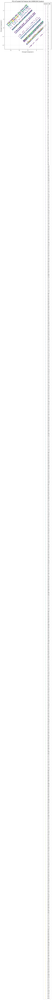

<ipython-input-119-4d39078f9134>:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=cluster_counts_hdbscan.index, y=cluster_counts_hdbscan.values, palette='viridis')


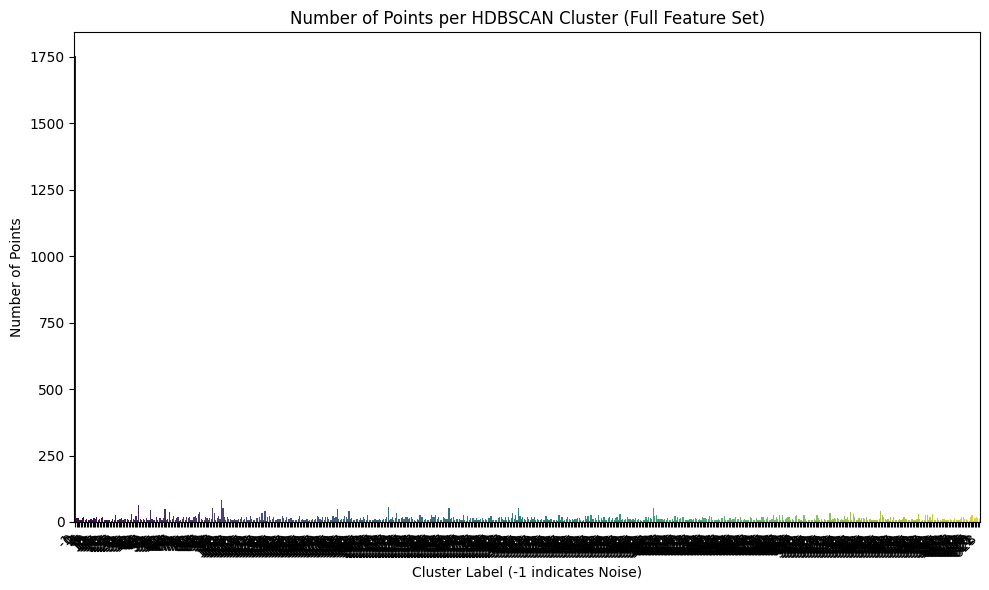

<ipython-input-119-4d39078f9134>:42: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Metric', y='Score', data=results_df_hdbscan, palette='tab10')


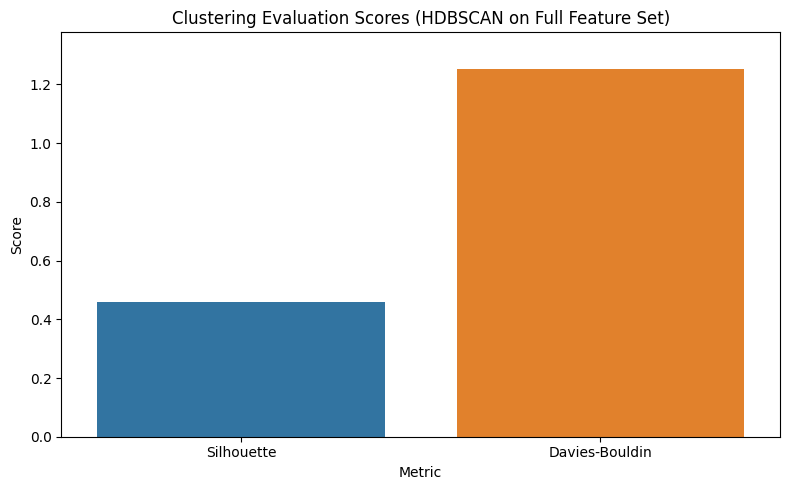

<ipython-input-119-4d39078f9134>:60: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Method', y='Score', data=all_silhouette_scores, palette='viridis')


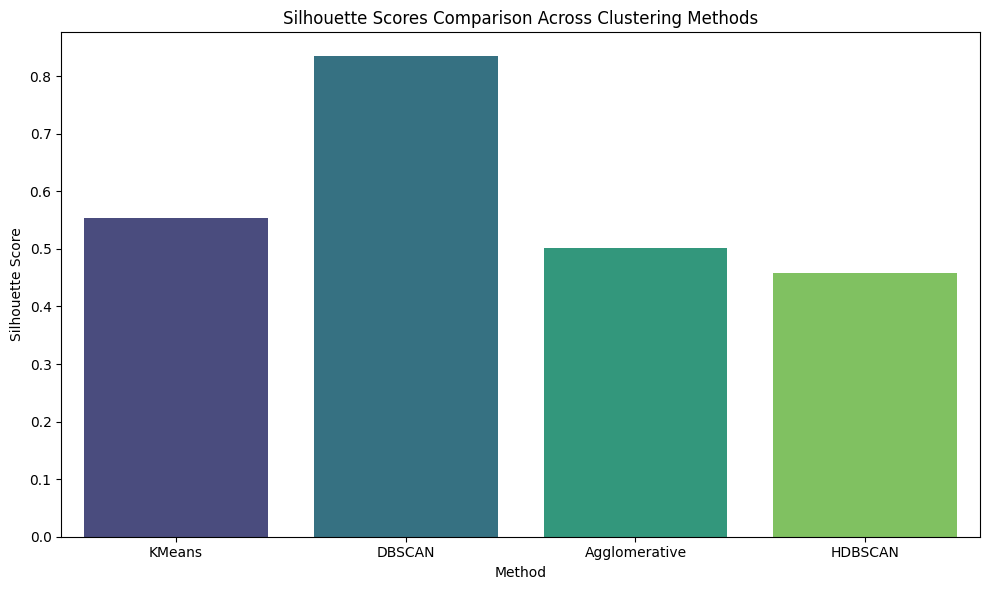

<ipython-input-119-4d39078f9134>:74: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Method', y='Score', data=all_davies_bouldin_scores, palette='plasma')


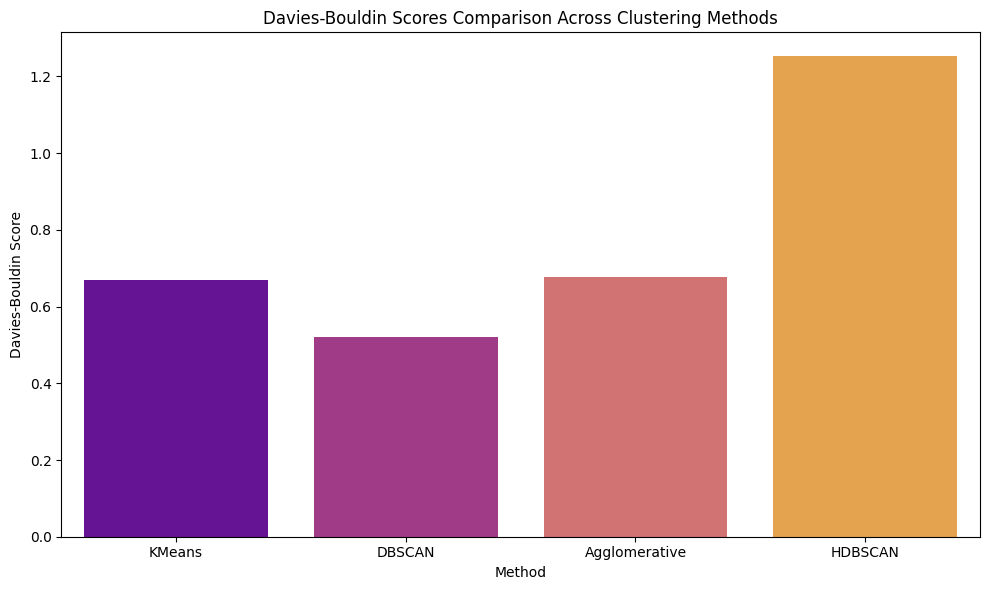

In [ ]:
# Visualize HDBSCAN Clusters on PCA reduced data
# Assuming 'cluster_labels' from the last HDBSCAN run (cells 112-116) is available and corresponds to principalDf54

plt.figure(figsize=(8, 8))
# Create a temporary DataFrame for plotting that includes PCA components and HDBSCAN cluster labels
plot_df54_hdb = principalDf54.copy()
plot_df54_hdb['cluster4_hdb'] = cluster_labels # Use the cluster_labels from the final HDBSCAN run

# Plotting the points with cluster assignments
sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster4_hdb', data=plot_df54_hdb,
                palette='viridis', legend='full', alpha=0.6, s=20)

plt.title('PCA of Scaled Full Feature Set (HDBSCAN Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Analyze the number of points in each HDBSCAN cluster (for the full feature set)
# Using the 'cluster_labels' variable from the last HDBSCAN run
cluster_counts_hdbscan = pd.Series(cluster_labels).value_counts().sort_index()

plt.figure(figsize=(10, 6))
sns.barplot(x=cluster_counts_hdbscan.index, y=cluster_counts_hdbscan.values, palette='viridis')
plt.title('Number of Points per HDBSCAN Cluster (Full Feature Set)')
plt.xlabel('Cluster Label (-1 indicates Noise)')
plt.ylabel('Number of Points')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


# Visualize Silhouette and Davies-Bouldin Scores for HDBSCAN (assuming they were calculated and stored in SilhouetteTable5 and DaviesBouldinTable5)
# Check if the 'HDBSCAN' key exists before attempting to access it
if 'HDBSCAN' in SilhouetteTable5.columns and 'HDBSCAN' in DaviesBouldinTable5.columns:
    results_df_hdbscan = pd.DataFrame({
        'Metric': ['Silhouette', 'Davies-Bouldin'],
        'Score': [SilhouetteTable5['HDBSCAN'].iloc[0], DaviesBouldinTable5['HDBSCAN'].iloc[0]]
    })

    plt.figure(figsize=(8, 5))
    sns.barplot(x='Metric', y='Score', data=results_df_hdbscan, palette='tab10')
    plt.title('Clustering Evaluation Scores (HDBSCAN on Full Feature Set)')
    plt.ylabel('Score')
    plt.ylim(0, max(results_df_hdbscan['Score']) * 1.1) # Adjust y-limit for better visualization
    plt.tight_layout()
    plt.show()
else:
    print("Silhouette and Davies-Bouldin scores for HDBSCAN were not found in the tables.")

# Optional: Compare Silhouette and Davies-Bouldin scores across all methods if tables contain the data
if 'KMEAN' in SilhouetteTable5.columns and 'DBSCAN' in SilhouetteTable5.columns and 'HIERARCHICAL_AGGLO_AVE' in SilhouetteTable5.columns and 'HDBSCAN' in SilhouetteTable5.columns:
    all_silhouette_scores = pd.DataFrame({
        'Method': ['KMeans', 'DBSCAN', 'Agglomerative', 'HDBSCAN'],
        'Score': [SilhouetteTable5['KMEAN'].iloc[0], SilhouetteTable5['DBSCAN'].iloc[0],
                  SilhouetteTable5['HIERARCHICAL_AGGLO_AVE'].iloc[0], SilhouetteTable5['HDBSCAN'].iloc[0]]
    })

    plt.figure(figsize=(10, 6))
    sns.barplot(x='Method', y='Score', data=all_silhouette_scores, palette='viridis')
    plt.title('Silhouette Scores Comparison Across Clustering Methods')
    plt.ylabel('Silhouette Score')
    plt.tight_layout()
    plt.show()

if 'KMEAN' in DaviesBouldinTable5.columns and 'DBSCAN' in DaviesBouldinTable5.columns and 'HIERARCHICAL_AGGLO_AVE' in DaviesBouldinTable5.columns and 'HDBSCAN' in DaviesBouldinTable5.columns:
    all_davies_bouldin_scores = pd.DataFrame({
        'Method': ['KMeans', 'DBSCAN', 'Agglomerative', 'HDBSCAN'],
        'Score': [DaviesBouldinTable5['KMEAN'].iloc[0], DaviesBouldinTable5['DBSCAN'].iloc[0],
                  DaviesBouldinTable5['HIERARCHICAL_AGGLO_AVE'].iloc[0], DaviesBouldinTable5['HDBSCAN'].iloc[0]]
    })

    plt.figure(figsize=(10, 6))
    sns.barplot(x='Method', y='Score', data=all_davies_bouldin_scores, palette='plasma')
    plt.title('Davies-Bouldin Scores Comparison Across Clustering Methods')
    plt.ylabel('Davies-Bouldin Score')
    plt.tight_layout()
    plt.show()

OPTICS

Dropping columns

In [ ]:
imp_sample_d_1 = sample_d_1.drop(['DR_NO', 'Date Rptd','DATE OCC', 'TIME OCC','AREA','Rpt Dist No', 'Part 1-2','Crm Cd Desc',
                                  'Vict Age','Vict Descent', 'Premis Desc', 'Weapon Desc','Weapon Used Cd', 'Status', 'Status Desc', 'Crm Cd 1',
                                  'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4','LOCATION','Cross Street','AREA NAME', 'LAT','LON', 'Mocodes' ],axis = 1)


Keeping only Crime and Premis in main df since others are encoded

In [ ]:
imp_sample_d_1 = imp_sample_d_1.drop(['Vict Sex','hour','AREA_LOCATION'], axis=1)

1. Gender Area

In [ ]:
ga = pd.concat([victim_encoded_df,place_encoded_df ],axis = 1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb51 = sc.fit_transform(ga)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb51)

principalDf51 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import OPTICS

clustering = OPTICS()

labels = clustering.fit_predict(principalDf51)

imp_sample_d_1['cluster1_o'] = labels

/usr/local/lib/python3.11/dist-packages/sklearn/cluster/_optics.py:1086: RuntimeWarning: divide by zero encountered in divide
  ratio = reachability_plot[:-1] / reachability_plot[1:]


2. Gender Area Premise

In [ ]:
imp_sample_d_11 = imp_sample_d_1.drop(['Crm Cd'],axis = 1)
#imp_sample_d_11.head(1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb52 = sc.fit_transform(imp_sample_d_11)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb52)

principalDf52 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import OPTICS

clustering = OPTICS()

labels = clustering.fit_predict(principalDf52)

imp_sample_d_1['cluster2_o'] = labels

/usr/local/lib/python3.11/dist-packages/sklearn/cluster/_optics.py:1086: RuntimeWarning: divide by zero encountered in divide
  ratio = reachability_plot[:-1] / reachability_plot[1:]


3. Gender Area Premise Hour


In [ ]:
imp_sample_d_12 = imp_sample_d_1.drop(['Crm Cd','Premis Cd','cluster1_o'],axis = 1)
#imp_sample_d_12.head(1)

In [ ]:
gaph = pd.concat([hour_encoded_df, imp_sample_d_12],axis = 1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb53 = sc.fit_transform(gaph)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb53)

principalDf53 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import OPTICS

clustering = OPTICS()

labels = clustering.fit_predict(principalDf53)

imp_sample_d_1['cluster3_o'] = labels

/usr/local/lib/python3.11/dist-packages/sklearn/cluster/_optics.py:1086: RuntimeWarning: divide by zero encountered in divide
  ratio = reachability_plot[:-1] / reachability_plot[1:]


4. Gender Area Premise Hour Crime

In [ ]:
imp_sample_d_13 = imp_sample_d_1.drop(['cluster2_o','Premis Cd','cluster1_o'],axis = 1)
imp_sample_d_13.head(1)

,Crm Cd,cluster3_o
216314,341.0,0


FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb54 = sc.fit_transform(imp_sample_d_13)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb54)

principalDf54 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import OPTICS

clustering = OPTICS()

labels = clustering.fit_predict(principalDf54)

imp_sample_d_1['cluster4_o'] = labels

/usr/local/lib/python3.11/dist-packages/sklearn/cluster/_optics.py:1086: RuntimeWarning: divide by zero encountered in divide
  ratio = reachability_plot[:-1] / reachability_plot[1:]


Silhouette Score

In [ ]:
from sklearn.metrics import silhouette_score

SilhouetteTable5['OPTICS'] =  [silhouette_score(principalDf54,imp_sample_d_1['cluster4_o'] )]

Davies Bouldin Score

In [ ]:
from sklearn.metrics import davies_bouldin_score
DaviesBouldinTable5['OPTICS'] =  [davies_bouldin_score(principalDf54, imp_sample_d_1['cluster4_o'])]

# UPDATED PLOTS

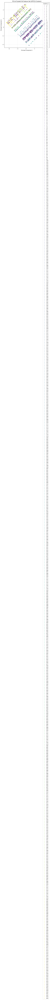

<ipython-input-141-b6666a0704fa>:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=cluster_counts_optics.index, y=cluster_counts_optics.values, palette='viridis')


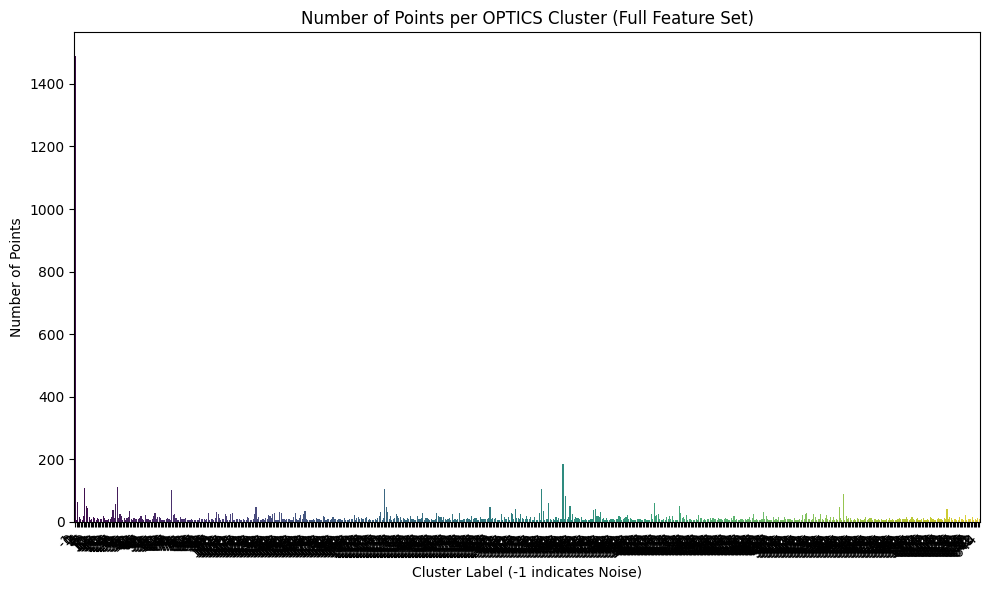

<ipython-input-141-b6666a0704fa>:41: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Metric', y='Score', data=results_df_optics, palette='tab10')


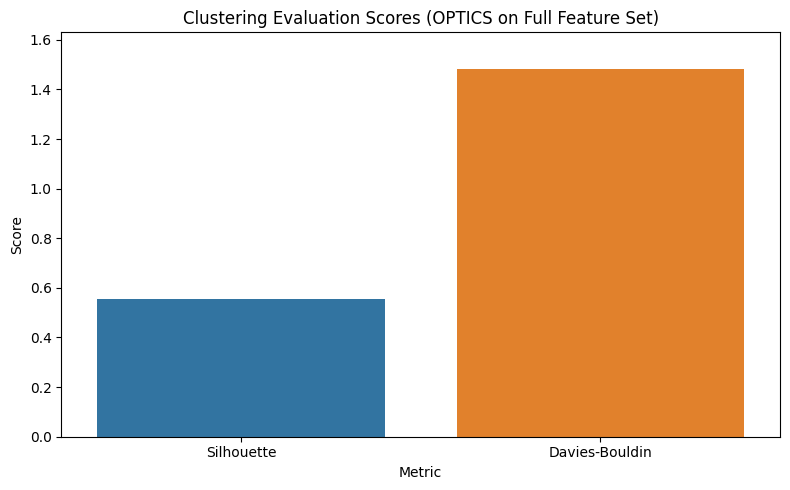

<ipython-input-141-b6666a0704fa>:61: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Method', y='Score', data=all_silhouette_scores, palette='viridis')


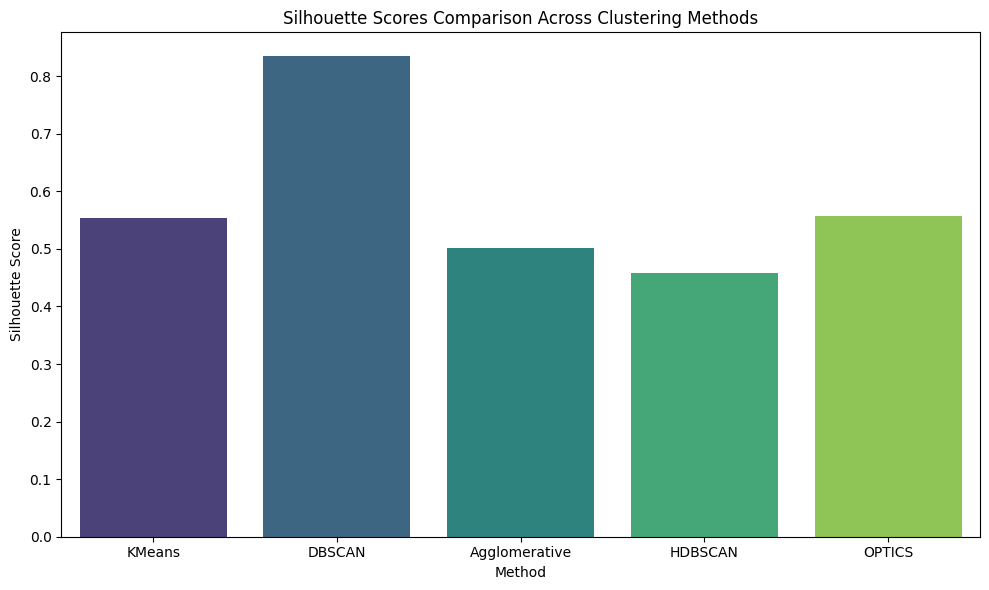

<ipython-input-141-b6666a0704fa>:78: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Method', y='Score', data=all_davies_bouldin_scores, palette='plasma')


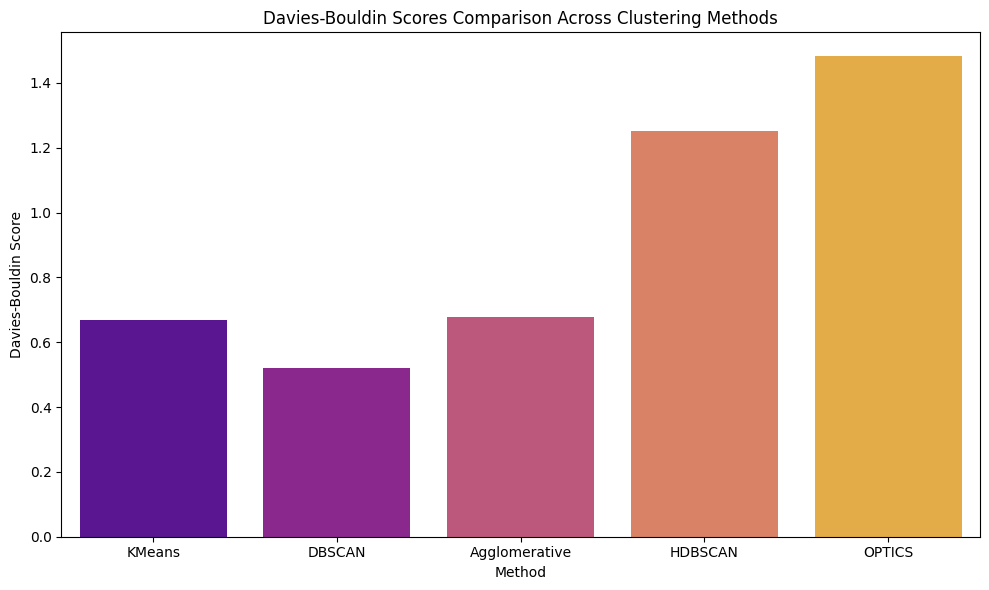

In [ ]:
# Visualize OPTICS Clusters on PCA reduced data
# Assuming 'labels' from the last OPTICS run (cells 133-137) is available and corresponds to principalDf54

plt.figure(figsize=(8, 8))
# Create a temporary DataFrame for plotting that includes PCA components and OPTICS cluster labels
plot_df54_optics = principalDf54.copy()
plot_df54_optics['cluster4_o'] = labels # Use the cluster_labels from the final OPTICS run

# Plotting the points with cluster assignments
sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster4_o', data=plot_df54_optics,
                palette='viridis', legend='full', alpha=0.6, s=20)

plt.title('PCA of Scaled Full Feature Set (OPTICS Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Analyze the number of points in each OPTICS cluster (for the full feature set)
# Using the 'labels' variable from the last OPTICS run
cluster_counts_optics = pd.Series(labels).value_counts().sort_index()

plt.figure(figsize=(10, 6))
sns.barplot(x=cluster_counts_optics.index, y=cluster_counts_optics.values, palette='viridis')
plt.title('Number of Points per OPTICS Cluster (Full Feature Set)')
plt.xlabel('Cluster Label (-1 indicates Noise)')
plt.ylabel('Number of Points')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Visualize Silhouette and Davies-Bouldin Scores for OPTICS (assuming they were calculated and stored)
# Check if the 'OPTICS' key exists before attempting to access it
if 'OPTICS' in SilhouetteTable5.columns and 'OPTICS' in DaviesBouldinTable5.columns:
    results_df_optics = pd.DataFrame({
        'Metric': ['Silhouette', 'Davies-Bouldin'],
        'Score': [SilhouetteTable5['OPTICS'].iloc[0], DaviesBouldinTable5['OPTICS'].iloc[0]]
    })

    plt.figure(figsize=(8, 5))
    sns.barplot(x='Metric', y='Score', data=results_df_optics, palette='tab10')
    plt.title('Clustering Evaluation Scores (OPTICS on Full Feature Set)')
    plt.ylabel('Score')
    plt.ylim(0, max(results_df_optics['Score']) * 1.1) # Adjust y-limit for better visualization
    plt.tight_layout()
    plt.show()
else:
    print("Silhouette and Davies-Bouldin scores for OPTICS were not found in the tables.")

# Optional: Compare Silhouette and Davies-Bouldin scores across all methods if tables contain the data
# Re-checking presence of all method scores before plotting
if 'KMEAN' in SilhouetteTable5.columns and 'DBSCAN' in SilhouetteTable5.columns and 'HIERARCHICAL_AGGLO_AVE' in SilhouetteTable5.columns and 'HDBSCAN' in SilhouetteTable5.columns and 'OPTICS' in SilhouetteTable5.columns:
    all_silhouette_scores = pd.DataFrame({
        'Method': ['KMeans', 'DBSCAN', 'Agglomerative', 'HDBSCAN', 'OPTICS'],
        'Score': [SilhouetteTable5['KMEAN'].iloc[0], SilhouetteTable5['DBSCAN'].iloc[0],
                  SilhouetteTable5['HIERARCHICAL_AGGLO_AVE'].iloc[0], SilhouetteTable5['HDBSCAN'].iloc[0],
                  SilhouetteTable5['OPTICS'].iloc[0]]
    })

    plt.figure(figsize=(10, 6))
    sns.barplot(x='Method', y='Score', data=all_silhouette_scores, palette='viridis')
    plt.title('Silhouette Scores Comparison Across Clustering Methods')
    plt.ylabel('Silhouette Score')
    plt.tight_layout()
    plt.show()
else:
    print("Not all Silhouette scores are available for comparison.")

if 'KMEAN' in DaviesBouldinTable5.columns and 'DBSCAN' in DaviesBouldinTable5.columns and 'HIERARCHICAL_AGGLO_AVE' in DaviesBouldinTable5.columns and 'HDBSCAN' in DaviesBouldinTable5.columns and 'OPTICS' in DaviesBouldinTable5.columns:
    all_davies_bouldin_scores = pd.DataFrame({
        'Method': ['KMeans', 'DBSCAN', 'Agglomerative', 'HDBSCAN', 'OPTICS'],
        'Score': [DaviesBouldinTable5['KMEAN'].iloc[0], DaviesBouldinTable5['DBSCAN'].iloc[0],
                  DaviesBouldinTable5['HIERARCHICAL_AGGLO_AVE'].iloc[0], DaviesBouldinTable5['HDBSCAN'].iloc[0],
                  DaviesBouldinTable5['OPTICS'].iloc[0]]
    })

    plt.figure(figsize=(10, 6))
    sns.barplot(x='Method', y='Score', data=all_davies_bouldin_scores, palette='plasma')
    plt.title('Davies-Bouldin Scores Comparison Across Clustering Methods')
    plt.ylabel('Davies-Bouldin Score')
    plt.tight_layout()
    plt.show()
else:
    print("Not all Davies-Bouldin scores are available for comparison.")

BIRCH

Dropping columns

In [ ]:
imp_sample_d_1 = sample_d_1.drop(['DR_NO', 'Date Rptd','DATE OCC', 'TIME OCC','AREA','Rpt Dist No', 'Part 1-2','Crm Cd Desc',
                                  'Vict Age','Vict Descent', 'Premis Desc', 'Weapon Desc','Weapon Used Cd', 'Status', 'Status Desc', 'Crm Cd 1',
                                  'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4','LOCATION','Cross Street','AREA NAME', 'LAT','LON', 'Mocodes' ],axis = 1)


Keeping only Crime and Premis in main df since others are encoded

In [ ]:
imp_sample_d_1 = imp_sample_d_1.drop(['Vict Sex','hour','AREA_LOCATION'], axis=1)

1. Gender Area

In [ ]:
ga = pd.concat([victim_encoded_df,place_encoded_df ],axis = 1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb51 = sc.fit_transform(ga)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb51)

principalDf51 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import Birch

birch = Birch(n_clusters=4)

cluster_b = birch.fit_predict(principalDf51)

imp_sample_d_1['cluster1_b'] = cluster_b

2. Gender Area Premise

In [ ]:
imp_sample_d_11 = imp_sample_d_1.drop(['Crm Cd'],axis = 1)
#imp_sample_d_11.head(1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb52 = sc.fit_transform(imp_sample_d_11)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb52)

principalDf52 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import Birch

birch = Birch(n_clusters=4)

cluster_b = birch.fit_predict(principalDf52)

imp_sample_d_1['cluster2_b'] = cluster_b

3. Gender Area Premise Hour


In [ ]:
imp_sample_d_12 = imp_sample_d_1.drop(['Crm Cd','Premis Cd','cluster1_b'],axis = 1)
#imp_sample_d_12.head(1)

In [ ]:
gaph = pd.concat([hour_encoded_df, imp_sample_d_12],axis = 1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb53 = sc.fit_transform(gaph)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb53)

principalDf53 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import Birch

birch = Birch(n_clusters=4)

cluster_b = birch.fit_predict(principalDf53)

imp_sample_d_1['cluster3_b'] = cluster_b

4. Gender Area Premise Hour Crime

In [ ]:
imp_sample_d_13 = imp_sample_d_1.drop(['cluster2_b','Premis Cd','cluster1_b'],axis = 1)
imp_sample_d_13.head(1)

,Crm Cd,cluster3_b
216314,341.0,3


FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb54 = sc.fit_transform(imp_sample_d_13)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb54)

principalDf54 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import Birch

birch = Birch(n_clusters=4)

cluster_b = birch.fit_predict(principalDf54)

imp_sample_d_1['cluster4_b'] = cluster_b

Silhouette Score

In [ ]:
from sklearn.metrics import silhouette_score

SilhouetteTable5['BIRCH'] =  [silhouette_score(principalDf54,imp_sample_d_1['cluster4_b'] )]

Davies Bouldin Score

In [ ]:
from sklearn.metrics import davies_bouldin_score
DaviesBouldinTable5['BIRCH'] =  [davies_bouldin_score(principalDf54, imp_sample_d_1['cluster4_b'])]

# UPDATED PLOTS

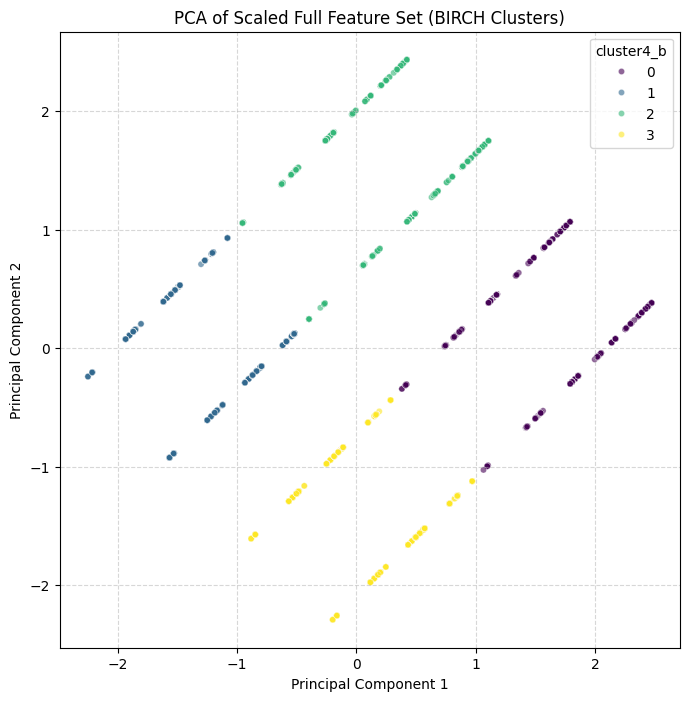

<ipython-input-163-9716c17bdc98>:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=cluster_counts_birch.index, y=cluster_counts_birch.values, palette='viridis')


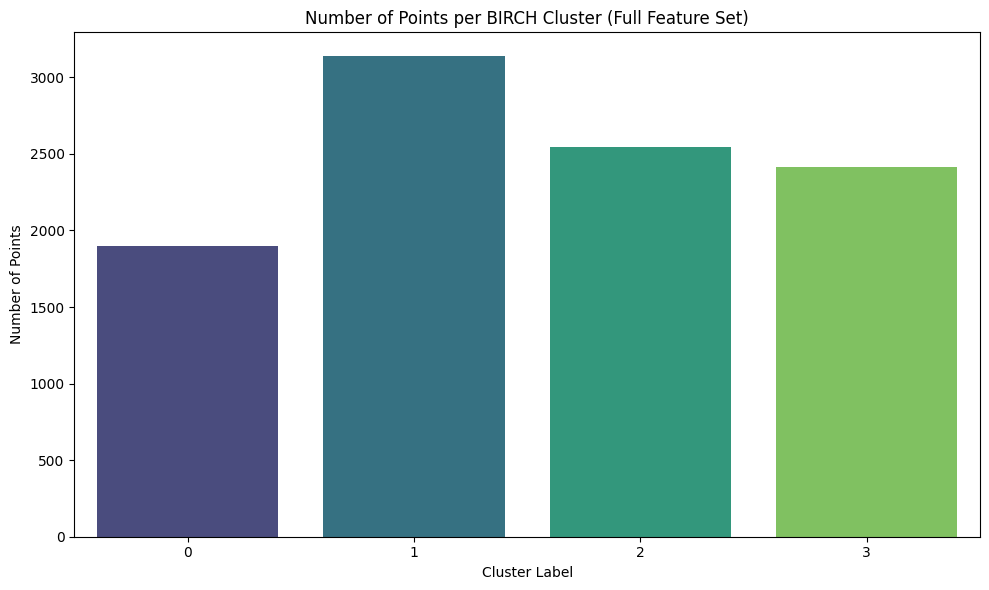

<ipython-input-163-9716c17bdc98>:42: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Metric', y='Score', data=results_df_birch, palette='tab10')


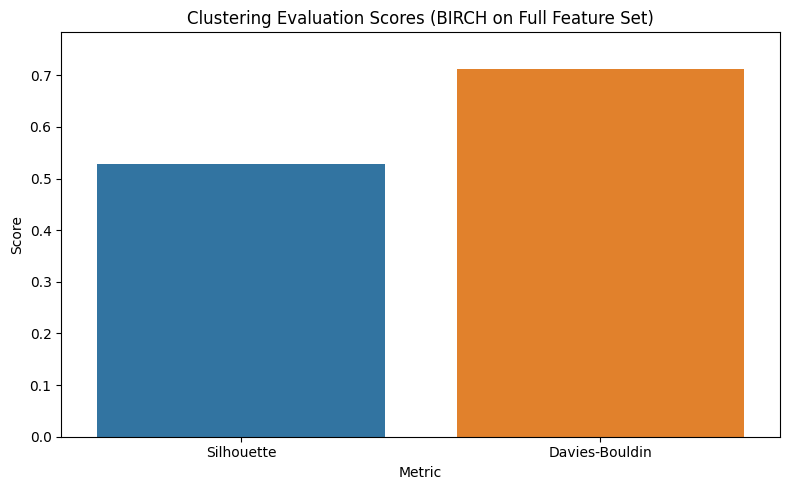

<ipython-input-163-9716c17bdc98>:62: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Method', y='Score', data=all_silhouette_scores, palette='viridis')


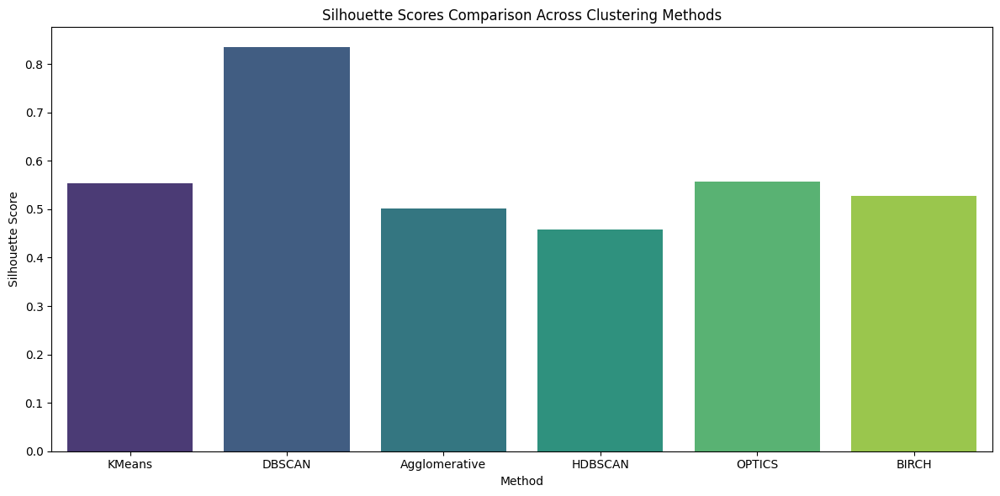

<ipython-input-163-9716c17bdc98>:79: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Method', y='Score', data=all_davies_bouldin_scores, palette='plasma')


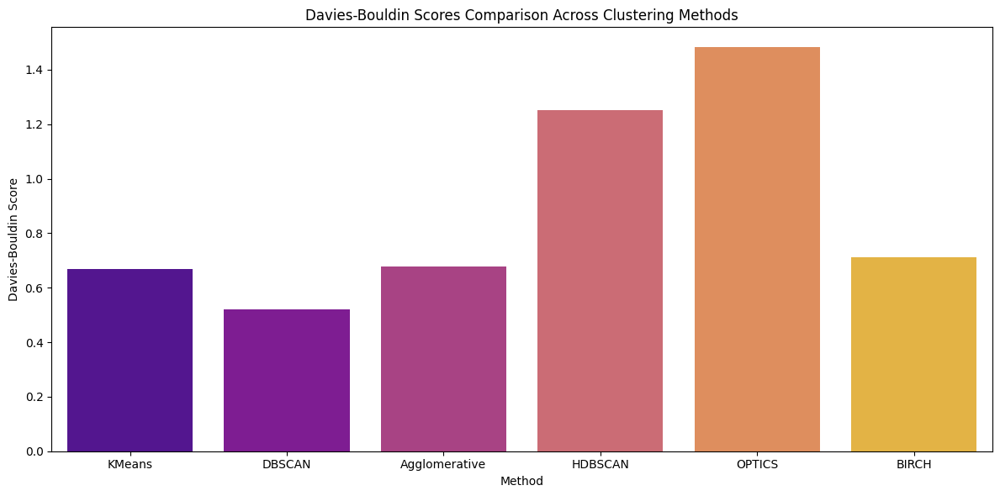

In [ ]:

# Visualize BIRCH Clusters on PCA reduced data
# Assuming 'cluster_b' from the last BIRCH run (cells 158-162) is available and corresponds to principalDf54

plt.figure(figsize=(8, 8))
# Create a temporary DataFrame for plotting that includes PCA components and BIRCH cluster labels
plot_df54_birch = principalDf54.copy()
plot_df54_birch['cluster4_b'] = cluster_b # Use the cluster_b from the final BIRCH run

# Plotting the points with cluster assignments
sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster4_b', data=plot_df54_birch,
                palette='viridis', legend='full', alpha=0.6, s=20)

plt.title('PCA of Scaled Full Feature Set (BIRCH Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Analyze the number of points in each BIRCH cluster (for the full feature set)
# Using the 'cluster_b' variable from the last BIRCH run
cluster_counts_birch = pd.Series(cluster_b).value_counts().sort_index()

plt.figure(figsize=(10, 6))
sns.barplot(x=cluster_counts_birch.index, y=cluster_counts_birch.values, palette='viridis')
plt.title('Number of Points per BIRCH Cluster (Full Feature Set)')
plt.xlabel('Cluster Label')
plt.ylabel('Number of Points')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


# Visualize Silhouette and Davies-Bouldin Scores for BIRCH (assuming they were calculated and stored)
# Check if the 'BIRCH' key exists before attempting to access it
if 'BIRCH' in SilhouetteTable5.columns and 'BIRCH' in DaviesBouldinTable5.columns:
    results_df_birch = pd.DataFrame({
        'Metric': ['Silhouette', 'Davies-Bouldin'],
        'Score': [SilhouetteTable5['BIRCH'].iloc[0], DaviesBouldinTable5['BIRCH'].iloc[0]]
    })

    plt.figure(figsize=(8, 5))
    sns.barplot(x='Metric', y='Score', data=results_df_birch, palette='tab10')
    plt.title('Clustering Evaluation Scores (BIRCH on Full Feature Set)')
    plt.ylabel('Score')
    plt.ylim(0, max(results_df_birch['Score']) * 1.1) # Adjust y-limit for better visualization
    plt.tight_layout()
    plt.show()
else:
    print("Silhouette and Davies-Bouldin scores for BIRCH were not found in the tables.")

# Optional: Compare Silhouette and Davies-Bouldin scores across all methods including BIRCH
# Re-checking presence of all method scores before plotting
if 'KMEAN' in SilhouetteTable5.columns and 'DBSCAN' in SilhouetteTable5.columns and 'HIERARCHICAL_AGGLO_AVE' in SilhouetteTable5.columns and 'HDBSCAN' in SilhouetteTable5.columns and 'OPTICS' in SilhouetteTable5.columns and 'BIRCH' in SilhouetteTable5.columns:
    all_silhouette_scores = pd.DataFrame({
        'Method': ['KMeans', 'DBSCAN', 'Agglomerative', 'HDBSCAN', 'OPTICS', 'BIRCH'],
        'Score': [SilhouetteTable5['KMEAN'].iloc[0], SilhouetteTable5['DBSCAN'].iloc[0],
                  SilhouetteTable5['HIERARCHICAL_AGGLO_AVE'].iloc[0], SilhouetteTable5['HDBSCAN'].iloc[0],
                  SilhouetteTable5['OPTICS'].iloc[0], SilhouetteTable5['BIRCH'].iloc[0]]
    })

    plt.figure(figsize=(12, 6))
    sns.barplot(x='Method', y='Score', data=all_silhouette_scores, palette='viridis')
    plt.title('Silhouette Scores Comparison Across Clustering Methods')
    plt.ylabel('Silhouette Score')
    plt.tight_layout()
    plt.show()
else:
    print("Not all Silhouette scores are available for comparison.")

if 'KMEAN' in DaviesBouldinTable5.columns and 'DBSCAN' in DaviesBouldinTable5.columns and 'HIERARCHICAL_AGGLO_AVE' in DaviesBouldinTable5.columns and 'HDBSCAN' in DaviesBouldinTable5.columns and 'OPTICS' in DaviesBouldinTable5.columns and 'BIRCH' in DaviesBouldinTable5.columns:
    all_davies_bouldin_scores = pd.DataFrame({
        'Method': ['KMeans', 'DBSCAN', 'Agglomerative', 'HDBSCAN', 'OPTICS', 'BIRCH'],
        'Score': [DaviesBouldinTable5['KMEAN'].iloc[0], DaviesBouldinTable5['DBSCAN'].iloc[0],
                  DaviesBouldinTable5['HIERARCHICAL_AGGLO_AVE'].iloc[0], DaviesBouldinTable5['HDBSCAN'].iloc[0],
                  DaviesBouldinTable5['OPTICS'].iloc[0], DaviesBouldinTable5['BIRCH'].iloc[0]]
    })

    plt.figure(figsize=(12, 6))
    sns.barplot(x='Method', y='Score', data=all_davies_bouldin_scores, palette='plasma')
    plt.title('Davies-Bouldin Scores Comparison Across Clustering Methods')
    plt.ylabel('Davies-Bouldin Score')
    plt.tight_layout()
    plt.show()
else:
    print("Not all Davies-Bouldin scores are available for comparison.")


GMM

Dropping columns

In [ ]:
imp_sample_d_1 = sample_d_1.drop(['DR_NO', 'Date Rptd','DATE OCC', 'TIME OCC','AREA','Rpt Dist No', 'Part 1-2','Crm Cd Desc',
                                  'Vict Age','Vict Descent', 'Premis Desc', 'Weapon Desc','Weapon Used Cd', 'Status', 'Status Desc', 'Crm Cd 1',
                                  'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4','LOCATION','Cross Street','AREA NAME', 'LAT','LON', 'Mocodes' ],axis = 1)


Keeping only Crime and Premis in main df since others are encoded

In [ ]:
imp_sample_d_1 = imp_sample_d_1.drop(['Vict Sex','hour','AREA_LOCATION'], axis=1)

1. Gender Area

In [ ]:
ga = pd.concat([victim_encoded_df,place_encoded_df ],axis = 1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb51 = sc.fit_transform(ga)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb51)

principalDf51 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=4, random_state=42)
gmm.fit(principalDf51)

labels = gmm.predict(principalDf51)


imp_sample_d_1['cluster1_g'] = labels

2. Gender Area Premise

In [ ]:
imp_sample_d_11 = imp_sample_d_1.drop(['Crm Cd'],axis = 1)
#imp_sample_d_11.head(1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb52 = sc.fit_transform(imp_sample_d_11)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb52)

principalDf52 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=4, random_state=42)
gmm.fit(principalDf52)

labels = gmm.predict(principalDf52)


imp_sample_d_1['cluster2_g'] = labels

3. Gender Area Premise Hour


In [ ]:
imp_sample_d_12 = imp_sample_d_1.drop(['Crm Cd','Premis Cd','cluster1_g'],axis = 1)
#imp_sample_d_12.head(1)

In [ ]:
gaph = pd.concat([hour_encoded_df, imp_sample_d_12],axis = 1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb53 = sc.fit_transform(gaph)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb53)

principalDf53 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=4, random_state=42)
gmm.fit(principalDf53)

labels = gmm.predict(principalDf53)


imp_sample_d_1['cluster3_g'] = labels

4. Gender Area Premise Hour Crime

In [ ]:
imp_sample_d_13 = imp_sample_d_1.drop(['cluster2_g','Premis Cd','cluster1_g'],axis = 1)
imp_sample_d_13.head(1)

,Crm Cd,cluster3_g
216314,341.0,0


FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb54 = sc.fit_transform(imp_sample_d_13)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb54)

principalDf54 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=4, random_state=42)
gmm.fit(principalDf54)

labels = gmm.predict(principalDf54)


imp_sample_d_1['cluster4_g'] = labels

Silhouette Score

In [ ]:
from sklearn.metrics import silhouette_score

SilhouetteTable5['GMM'] =  [silhouette_score(principalDf54,imp_sample_d_1['cluster4_g'] )]

Davies Bouldin Score

In [ ]:
from sklearn.metrics import davies_bouldin_score
DaviesBouldinTable5['GMM'] =  [davies_bouldin_score(principalDf54, imp_sample_d_1['cluster4_g'])]

# UPDATED PLOTS

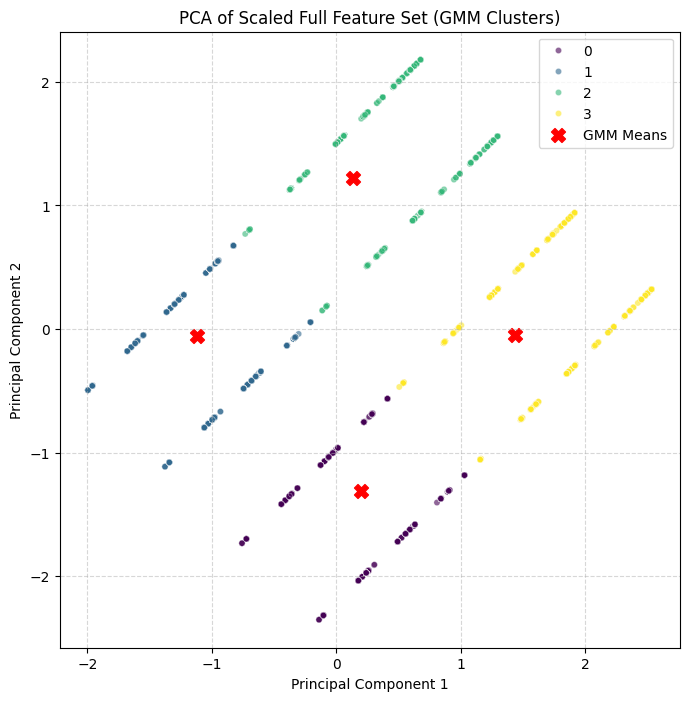

<ipython-input-189-6cb9b9356592>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=cluster_counts_gmm.index, y=cluster_counts_gmm.values, palette='viridis')


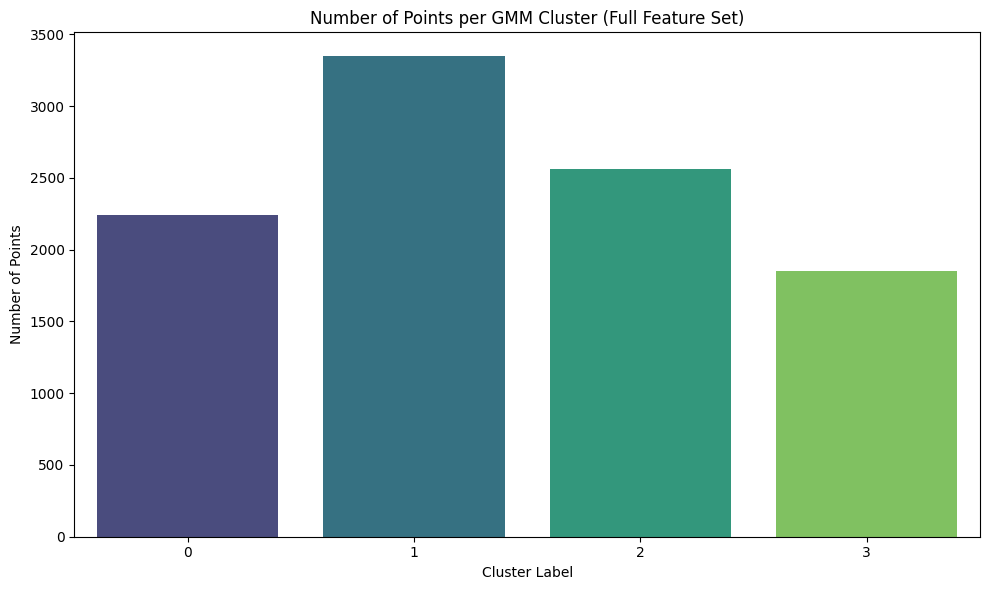

<ipython-input-189-6cb9b9356592>:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Metric', y='Score', data=results_df_gmm, palette='tab10')


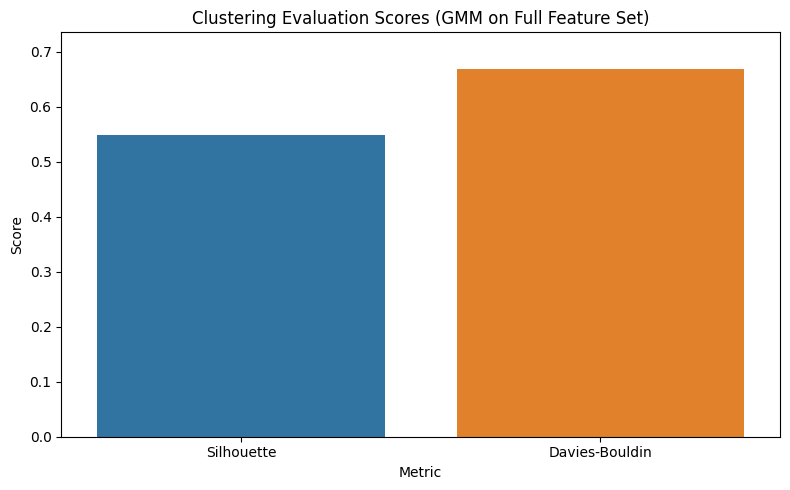

<ipython-input-189-6cb9b9356592>:75: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Method', y='Score', data=all_silhouette_scores, palette='viridis')


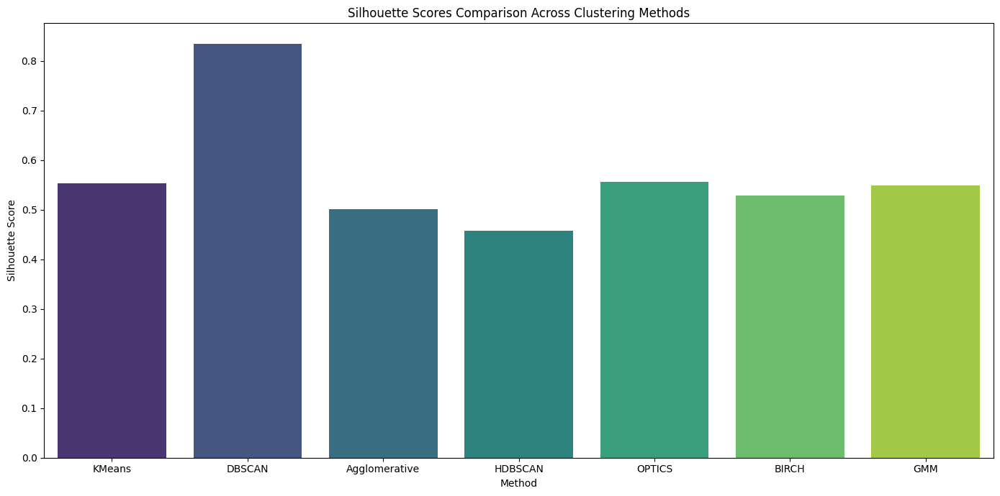

<ipython-input-189-6cb9b9356592>:90: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Method', y='Score', data=all_davies_bouldin_scores, palette='plasma')


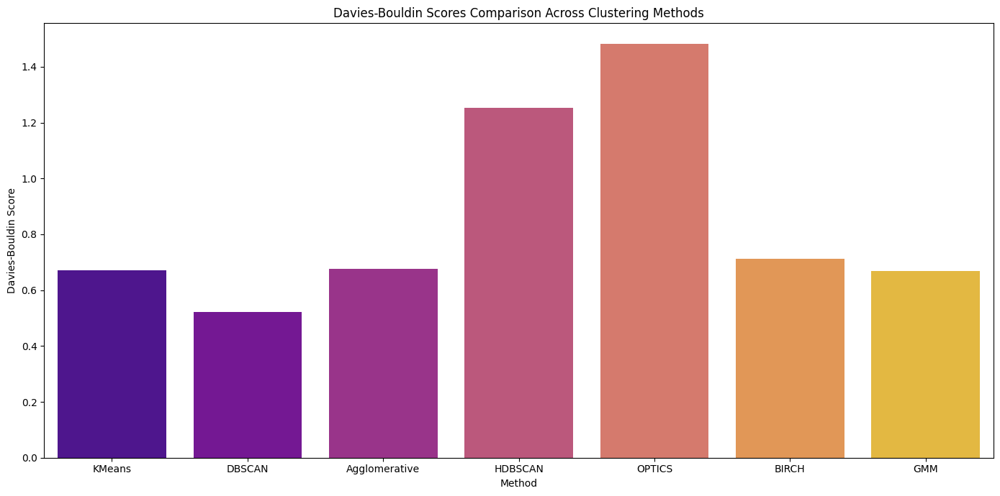

In [ ]:
#  UPDATED PLOTS for GMM

# Visualize GMM Clusters on PCA reduced data
# Assuming 'labels' from the last GMM run (cells 179-183) is available and corresponds to principalDf54

plt.figure(figsize=(8, 8))
# Create a temporary DataFrame for plotting that includes PCA components and GMM cluster labels
plot_df54_gmm = principalDf54.copy()
plot_df54_gmm['cluster4_g'] = labels # Use the cluster labels from the final GMM run

# Plotting the points with cluster assignments
sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster4_g', data=plot_df54_gmm,
                palette='viridis', legend='full', alpha=0.6, s=20)

# Add the means of the Gaussian components (similar to centroids in KMeans)
# Note: GMM centers are not simply centroids, but the mean of each Gaussian component
# We can plot them for visualization, but they represent the center of each Gaussian distribution
# Accessing means from the last fitted GMM model (assuming it's still the `gmm` variable)
if 'gmm' in locals() and hasattr(gmm, 'means_'):
    plt.scatter(gmm.means_[:, 0], gmm.means_[:, 1], marker='X', s=100, c='red', label='GMM Means')
    plt.legend()

plt.title('PCA of Scaled Full Feature Set (GMM Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Analyze the number of points assigned to each GMM component (for the full feature set)
# Using the 'labels' variable from the last GMM run
cluster_counts_gmm = pd.Series(labels).value_counts().sort_index()

plt.figure(figsize=(10, 6))
sns.barplot(x=cluster_counts_gmm.index, y=cluster_counts_gmm.values, palette='viridis')
plt.title('Number of Points per GMM Cluster (Full Feature Set)')
plt.xlabel('Cluster Label')
plt.ylabel('Number of Points')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


# Visualize Silhouette and Davies-Bouldin Scores for GMM (assuming they were calculated and stored)
# Check if the 'GMM' key exists before attempting to access it
if 'GMM' in SilhouetteTable5.columns and 'GMM' in DaviesBouldinTable5.columns:
    results_df_gmm = pd.DataFrame({
        'Metric': ['Silhouette', 'Davies-Bouldin'],
        'Score': [SilhouetteTable5['GMM'].iloc[0], DaviesBouldinTable5['GMM'].iloc[0]]
    })

    plt.figure(figsize=(8, 5))
    sns.barplot(x='Metric', y='Score', data=results_df_gmm, palette='tab10')
    plt.title('Clustering Evaluation Scores (GMM on Full Feature Set)')
    plt.ylabel('Score')
    plt.ylim(0, max(results_df_gmm['Score']) * 1.1) # Adjust y-limit for better visualization
    plt.tight_layout()
    plt.show()
else:
    print("Silhouette and Davies-Bouldin scores for GMM were not found in the tables.")

# Optional: Compare Silhouette and Davies-Bouldin scores across all methods including GMM
# Re-checking presence of all method scores before plotting
methods = ['KMEAN', 'DBSCAN', 'HIERARCHICAL_AGGLO_AVE', 'HDBSCAN', 'OPTICS', 'BIRCH', 'GMM']
silhouette_scores_available = all(method in SilhouetteTable5.columns for method in methods)
davies_bouldin_scores_available = all(method in DaviesBouldinTable5.columns for method in methods)


if silhouette_scores_available:
    all_silhouette_scores = pd.DataFrame({
        'Method': ['KMeans', 'DBSCAN', 'Agglomerative', 'HDBSCAN', 'OPTICS', 'BIRCH', 'GMM'],
        'Score': [SilhouetteTable5[method].iloc[0] for method in methods]
    })

    plt.figure(figsize=(14, 7))
    sns.barplot(x='Method', y='Score', data=all_silhouette_scores, palette='viridis')
    plt.title('Silhouette Scores Comparison Across Clustering Methods')
    plt.ylabel('Silhouette Score')
    plt.tight_layout()
    plt.show()
else:
    print("Not all Silhouette scores are available for comparison (including GMM).")

if davies_bouldin_scores_available:
    all_davies_bouldin_scores = pd.DataFrame({
        'Method': ['KMeans', 'DBSCAN', 'Agglomerative', 'HDBSCAN', 'OPTICS', 'BIRCH', 'GMM'],
        'Score': [DaviesBouldinTable5[method].iloc[0] for method in methods]
    })

    plt.figure(figsize=(14, 7))
    sns.barplot(x='Method', y='Score', data=all_davies_bouldin_scores, palette='plasma')
    plt.title('Davies-Bouldin Scores Comparison Across Clustering Methods')
    plt.ylabel('Davies-Bouldin Score')
    plt.tight_layout()
    plt.show()
else:
    print("Not all Davies-Bouldin scores are available for comparison (including GMM).")

# Optional: Plot the covariance ellipsoids for GMM clusters (requires accessing the fitted gmm model)
# This is a more advanced visualization and assumes the final GMM model on principalDf54 is stored in 'gmm'
# if 'gmm' in locals() and hasattr(gmm, 'means_') and hasattr(gmm, 'covariances_'):
#     import matplotlib.patches as patches
#     import numpy as np # Import numpy for calculations

#     plt.figure(figsize=(8, 8))
#     sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster4_g', data=plot_df54_hdb, # Ensure this uses the correct plotting dataframe
#                     palette='viridis', legend='full', alpha=0.6, s=20)

#     ax = plt.gca()

#     # Plot the covariance ellipsoids for each component
#     for i, (mean, covar, color) in enumerate(zip(gmm.means_, gmm.covariances_, sns.color_palette('viridis', n_colors=gmm.n_components))):
#         # Note: ellipsoids might not be perfect on the 2D PCA space if the original features have different scales/relationships
#         # This visualization is most accurate when the data is truly generated by GMM components in the plotted space.
#         v, w = np.linalg.eigh(covar)
#         v = 2. * np.sqrt(2.) * np.sqrt(v)
#         u = w[0] / np.linalg.norm(w[0])

#         angle = np.arctan2(u[1], u[0])
#         angle = 180. * angle / np.pi  # convert to degrees

#         # Pass color as a keyword argument
#         ell = patches.Ellipse(mean, v[0], v[1], 180. + angle, color=color)
#         ell.set_clip_box(ax.bbox)
#         ell.set_alpha(0.2)
#         ax.add_artist(ell)

#     plt.title('PCA of Scaled Full Feature Set with GMM Covariance Ellipsoids')
#     plt.xlabel('Principal Component 1')
#     plt.ylabel('Principal Component 2')
#     plt.grid(True, linestyle='--', alpha=0.5)
#     plt.show()

SPECTRAL

Dropping columns

In [ ]:
imp_sample_d_1 = sample_d_1.drop(['DR_NO', 'Date Rptd','DATE OCC', 'TIME OCC','AREA','Rpt Dist No', 'Part 1-2','Crm Cd Desc',
                                  'Vict Age','Vict Descent', 'Premis Desc', 'Weapon Desc','Weapon Used Cd', 'Status', 'Status Desc', 'Crm Cd 1',
                                  'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4','LOCATION','Cross Street','AREA NAME', 'LAT','LON', 'Mocodes' ],axis = 1)


Keeping only Crime and Premis in main df since others are encoded

In [ ]:
imp_sample_d_1 = imp_sample_d_1.drop(['Vict Sex','hour','AREA_LOCATION'], axis=1)

1. Gender Area

In [ ]:
ga = pd.concat([victim_encoded_df,place_encoded_df ],axis = 1)

In [ ]:
ga

,Vict Sex_F,Vict Sex_M,AREA_LOCATION_1.0 Central 00 GATEWAY PLAZ DR,AREA_LOCATION_1.0 Central 00 GATEWAY PLZ,AREA_LOCATION_1.0 Central 100 E 1ST ST,AREA_LOCATION_1.0 Central 100 E 5TH ST,AREA_LOCATION_1.0 Central 100 E 7TH ST,AREA_LOCATION_1.0 Central 100 E 8TH ST,AREA_LOCATION_1.0 Central 100 E 9TH ST,AREA_LOCATION_1.0 Central 100 E BLOOM ST,AREA_LOCATION_1.0 Central 100 N CENTRAL AV,AREA_LOCATION_1.0 Central 100 N HILL ST,AREA_LOCATION_1.0 Central 100 N JUDGE JOHN AISO ST,AREA_LOCATION_1.0 Central 100 PASEO DE LA,AREA_LOCATION_1.0 Central 100 PASEO DE LA PLAZA,AREA_LOCATION_1.0 Central 100 S FIGUEROA ST,AREA_LOCATION_1.0 Central 100 S HILL ST,AREA_LOCATION_1.0 Central 100 S LOS ANGELES ST,AREA_LOCATION_1.0 Central 100 W 2ND ST,AREA_LOCATION_1.0 Central 100 W 5TH ST,AREA_LOCATION_1.0 Central 100 W 7TH ST,AREA_LOCATION_1.0 Central 100 WINSTON ST,AREA_LOCATION_1.0 Central 1000 MAPLE AV,AREA_LOCATION_1.0 Central 1000 N ALAMEDA ST,AREA_LOCATION_1.0 Central 1000 N VIGNES ST,AREA_LOCATION_1.0 Central 1000 S BROADWAY,AREA_LOCATION_1.0 Central 1000 S FIGUEROA ST,AREA_LOCATION_1.0 Central 1000 S GRAND AV,AREA_LOCATION_1.0 Central 1000 S HILL ST,AREA_LOCATION_1.0 Central 1000 S HOPE ST,AREA_LOCATION_1.0 Central 1000 S OLIVE ST,AREA_LOCATION_1.0 Central 1000 W 8TH ST,AREA_LOCATION_1.0 Central 1100 E 5TH ST,AREA_LOCATION_1.0 Central 1100 S BROADWAY,AREA_LOCATION_1.0 Central 1100 S FIGUEROA ST,AREA_LOCATION_1.0 Central 1100 S FLOWER ST,AREA_LOCATION_1.0 Central 1100 S GRAND AV,AREA_LOCATION_1.0 Central 1100 S SANTEE ST,AREA_LOCATION_1.0 Central 1100 W SUNSET BL,AREA_LOCATION_1.0 Central 11TH,AREA_LOCATION_1.0 Central 11TH ST,AREA_LOCATION_1.0 Central 1200 E 6TH ST,AREA_LOCATION_1.0 Central 1200 INNES AV,AREA_LOCATION_1.0 Central 1200 MAPLE AV,AREA_LOCATION_1.0 Central 1200 N SPRING ST,AREA_LOCATION_1.0 Central 1200 S FIGUEROA ST,AREA_LOCATION_1.0 Central 1200 S GRAND AV,AREA_LOCATION_1.0 Central 1200 S HOPE ST,AREA_LOCATION_1.0 Central 1200 S MAIN ST,AREA_LOCATION_1.0 Central 1200 S OLIVE ST,AREA_LOCATION_1.0 Central 1200 WHOLESALE ST,AREA_LOCATION_1.0 Central 12TH,AREA_LOCATION_1.0 Central 1300 CARDINAL ST,AREA_LOCATION_1.0 Central 1300 CONWAY PL,AREA_LOCATION_1.0 Central 1300 E 6TH ST,AREA_LOCATION_1.0 Central 1300 FACTORY PL,AREA_LOCATION_1.0 Central 1300 S FIGUEROA ST,AREA_LOCATION_1.0 Central 1300 S HOPE ST,AREA_LOCATION_1.0 Central 1300 S MAIN ST,AREA_LOCATION_1.0 Central 1300 S SANTEE ST,AREA_LOCATION_1.0 Central 1300 W SUNSET BL,AREA_LOCATION_1.0 Central 1400 MAPLE AV,AREA_LOCATION_1.0 Central 1400 S FLOWER ST,AREA_LOCATION_1.0 Central 1400 S GRAND AV,AREA_LOCATION_1.0 Central 14TH ST,AREA_LOCATION_1.0 Central 1500 S FLOWER ST,AREA_LOCATION_1.0 Central 1600 S BROADWAY,AREA_LOCATION_1.0 Central 1600 S FLOWER ST,AREA_LOCATION_1.0 Central 1600 S HOPE ST,AREA_LOCATION_1.0 Central 1600 S MAIN ST,AREA_LOCATION_1.0 Central 1700 E 7TH ST,AREA_LOCATION_1.0 Central 1700 NAUD ST,AREA_LOCATION_1.0 Central 1700 S GEORGIA ST,AREA_LOCATION_1.0 Central 1700 S HILL ST,AREA_LOCATION_1.0 Central 17TH,AREA_LOCATION_1.0 Central 1800 S FIGUEROA ST,AREA_LOCATION_1.0 Central 18TH,AREA_LOCATION_1.0 Central 1ST,AREA_LOCATION_1.0 Central 1ST ST,AREA_LOCATION_1.0 Central 200 E 15TH ST,AREA_LOCATION_1.0 Central 200 E 2ND ST,AREA_LOCATION_1.0 Central 200 E 8TH ST,AREA_LOCATION_1.0 Central 200 N LOS ANGELES ST,AREA_LOCATION_1.0 Central 200 N MAIN ST,AREA_LOCATION_1.0 Central 200 S BROADWAY,AREA_LOCATION_1.0 Central 200 S FIGUEROA ST,AREA_LOCATION_1.0 Central 200 S GRAND AV,AREA_LOCATION_1.0 Central 200 S HILL ST,AREA_LOCATION_1.0 Central 200 S LOS ANGELES ST,AREA_LOCATION_1.0 Central 200 S MAIN ST,AREA_LOCATION_1.0 Central 200 S SPRING ST,AREA_LOCATION_1.0 Central 200 W 6TH ST,AREA_LOCATION_1.0 Central 200 W 7TH ST,AREA_LOCATION_1.0 Central 200 W TEMPLE ST,AREA_LOCATION_1.0 Central 2ND,AREA_LOCATION_1.0 Central 2ND ST,AREA_LOCATION_1.0 Central 300 AVERY ST,AREA_LOCATION_1.0 Central 300 CROCKER ST,AREA_LOCATION_1.0 Central 300 E 1ST ST,AREA_LOCATION_1.0 Central 

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb51 = sc.fit_transform(ga)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb51)

principalDf51 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

In [ ]:
allcomb51

array([[ 1.08981884, -1.08981884, -0.01414355, ..., -0.01414355,
        -0.0100005 , -0.01414355],
       [ 1.08981884, -1.08981884, -0.01414355, ..., -0.01414355,
        -0.0100005 , -0.01414355],
       [-0.9175837 ,  0.9175837 , -0.01414355, ..., -0.01414355,
        -0.0100005 , -0.01414355],
       ...,
       [-0.9175837 ,  0.9175837 , -0.01414355, ..., -0.01414355,
        -0.0100005 , -0.01414355],
       [-0.9175837 ,  0.9175837 , -0.01414355, ..., -0.01414355,
        -0.0100005 , -0.01414355],
       [-0.9175837 ,  0.9175837 , -0.01414355, ..., -0.01414355,
        -0.0100005 , -0.01414355]])

Algo

In [ ]:
from sklearn.cluster import SpectralClustering

spectral_model_rbf = SpectralClustering(n_clusters = 4, affinity ='rbf')

labels_rbf = spectral_model_rbf.fit_predict(principalDf51)

imp_sample_d_1['cluster1_s'] = labels_rbf

2. Gender Area Premise

In [ ]:
imp_sample_d_11 = imp_sample_d_1.drop(['Crm Cd'],axis = 1)
#imp_sample_d_11.head(1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb52 = sc.fit_transform(imp_sample_d_11)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb52)

principalDf52 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import SpectralClustering

spectral_model_rbf = SpectralClustering(n_clusters = 4, affinity ='rbf')

labels_rbf = spectral_model_rbf.fit_predict(principalDf52)

imp_sample_d_1['cluster2_s'] = labels_rbf

3. Gender Area Premise Hour


In [ ]:
imp_sample_d_12 = imp_sample_d_1.drop(['Crm Cd','Premis Cd','cluster1_s'],axis = 1)
#imp_sample_d_12.head(1)

In [ ]:
gaph = pd.concat([hour_encoded_df, imp_sample_d_12],axis = 1)

FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb53 = sc.fit_transform(gaph)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb53)

principalDf53 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import SpectralClustering

spectral_model_rbf = SpectralClustering(n_clusters = 4, affinity ='rbf')

labels_rbf = spectral_model_rbf.fit_predict(principalDf53)

imp_sample_d_1['cluster3_s'] = labels_rbf

4. Gender Area Premise Hour Crime

In [ ]:
imp_sample_d_13 = imp_sample_d_1.drop(['cluster2_s','Premis Cd','cluster1_s'],axis = 1)
imp_sample_d_13.head(1)

,Crm Cd,cluster3_s
216314,341.0,3


FEATURE SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

allcomb54 = sc.fit_transform(imp_sample_d_13)

PCA

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)

principalComponents = pca.fit_transform(allcomb54)

principalDf54 = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

Algo

In [ ]:
from sklearn.cluster import SpectralClustering

spectral_model_rbf = SpectralClustering(n_clusters = 4, affinity ='rbf')

labels_rbf = spectral_model_rbf.fit_predict(principalDf54)

imp_sample_d_1['cluster4_s'] = labels_rbf

# UPDATED PLOTS

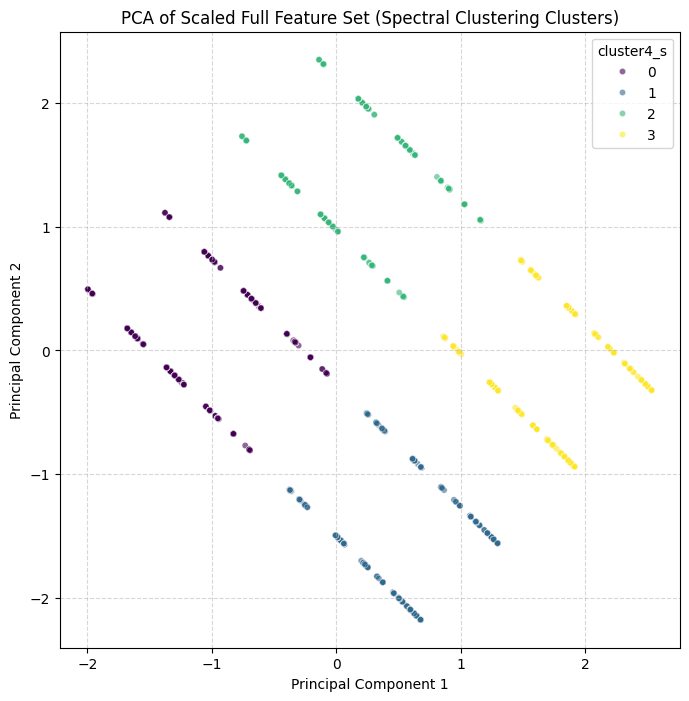

<ipython-input-212-43339b368c42>:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=cluster_counts_spectral.index, y=cluster_counts_spectral.values, palette='viridis')


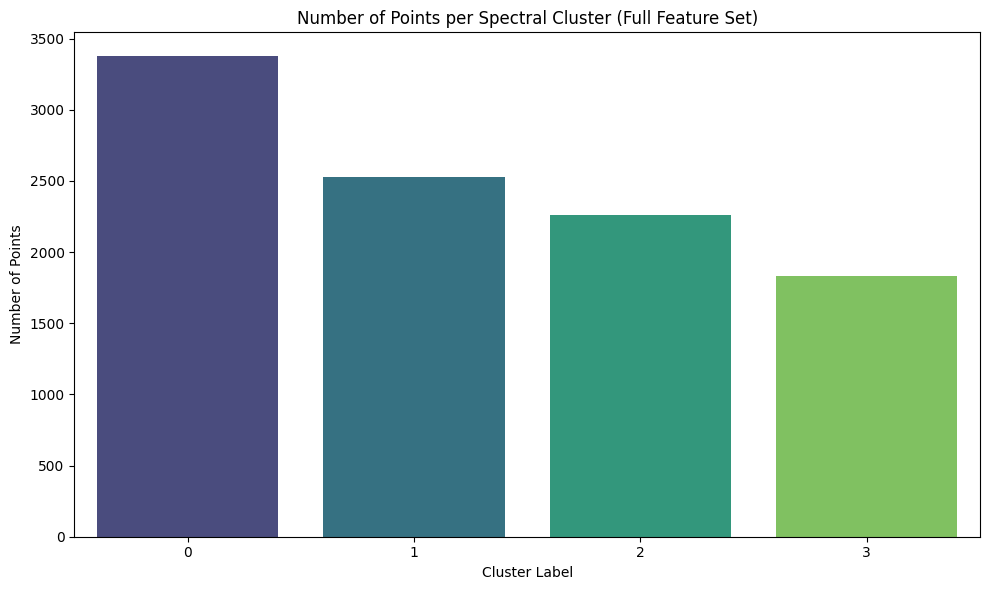

<ipython-input-212-43339b368c42>:61: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Metric', y='Score', data=results_df_spectral, palette='tab10')


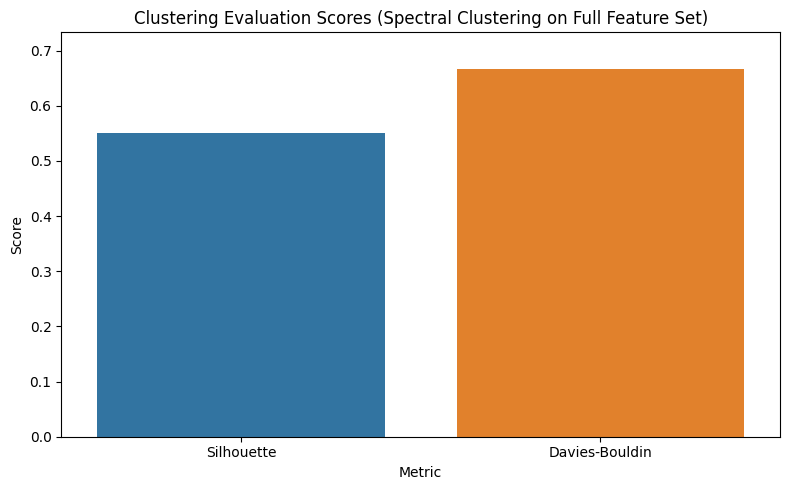

<ipython-input-212-43339b368c42>:87: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Method', y='Score', data=all_silhouette_scores_compare, palette='viridis')


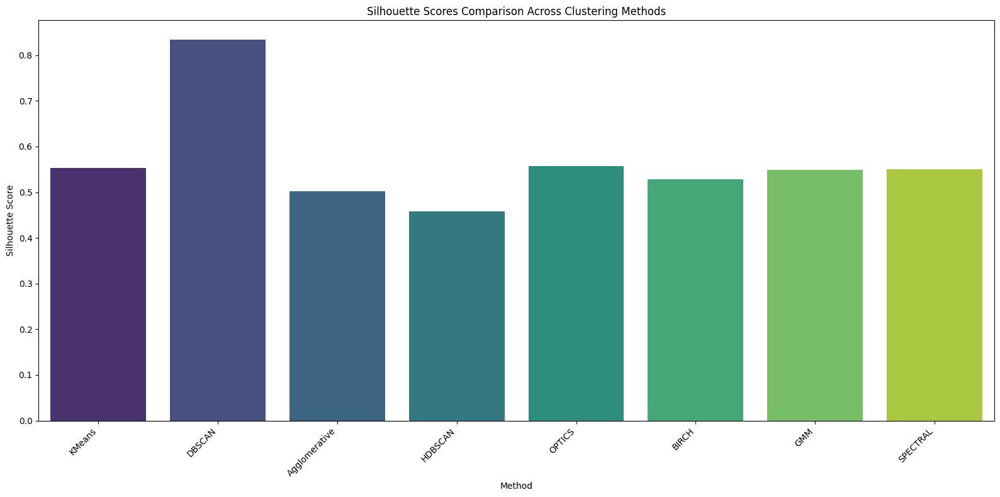

<ipython-input-212-43339b368c42>:103: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Method', y='Score', data=all_davies_bouldin_scores_compare, palette='plasma')


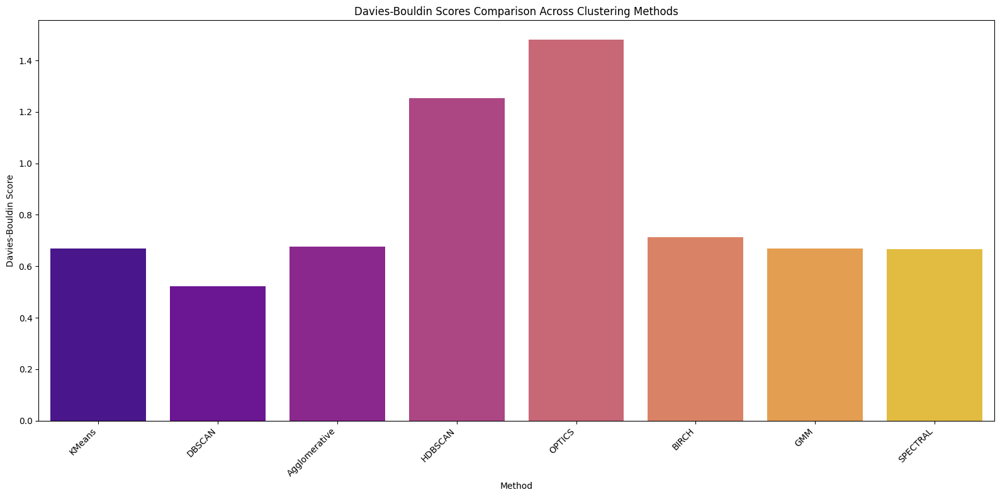

In [ ]:
# UPDATED PLOTS for SPECTRAL CLUSTERING

# Visualize Spectral Clustering Clusters on PCA reduced data
# Assuming 'labels_rbf' from the last Spectral Clustering run (cells 205-209) is available and corresponds to principalDf54

plt.figure(figsize=(8, 8))
# Create a temporary DataFrame for plotting that includes PCA components and Spectral cluster labels
plot_df54_spectral = principalDf54.copy()
plot_df54_spectral['cluster4_s'] = labels_rbf # Use the cluster labels from the final Spectral run

# Plotting the points with cluster assignments
sns.scatterplot(x='principal component 1', y='principal component 2', hue='cluster4_s', data=plot_df54_spectral,
                palette='viridis', legend='full', alpha=0.6, s=20)

plt.title('PCA of Scaled Full Feature Set (Spectral Clustering Clusters)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

# Analyze the number of points assigned to each Spectral cluster (for the full feature set)
# Using the 'labels_rbf' variable from the last Spectral run
cluster_counts_spectral = pd.Series(labels_rbf).value_counts().sort_index()

plt.figure(figsize=(10, 6))
sns.barplot(x=cluster_counts_spectral.index, y=cluster_counts_spectral.values, palette='viridis')
plt.title('Number of Points per Spectral Cluster (Full Feature Set)')
plt.xlabel('Cluster Label')
plt.ylabel('Number of Points')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

# Calculate Silhouette and Davies-Bouldin Scores for Spectral Clustering
try:
    spectral_silhouette_score = silhouette_score(principalDf54, labels_rbf)
    spectral_davies_bouldin_score = davies_bouldin_score(principalDf54, labels_rbf)

    # Store in the tables (if they are meant to accumulate results)
    # Assuming SilhouetteTable5 and DaviesBouldinTable5 exist and are meant for this
    if 'SilhouetteTable5' in locals() and isinstance(SilhouetteTable5, pd.DataFrame):
        SilhouetteTable5['SPECTRAL'] = [spectral_silhouette_score]
    else:
        print("SilhouetteTable5 not found, creating a new one for Spectral scores.")
        SilhouetteTable5 = pd.DataFrame({'SPECTRAL': [spectral_silhouette_score]})

    if 'DaviesBouldinTable5' in locals() and isinstance(DaviesBouldinTable5, pd.DataFrame):
        DaviesBouldinTable5['SPECTRAL'] = [spectral_davies_bouldin_score]
    else:
         print("DaviesBouldinTable5 not found, creating a new one for Spectral scores.")
         DaviesBouldinTable5 = pd.DataFrame({'SPECTRAL': [spectral_davies_bouldin_score]})


    # Visualize Silhouette and Davies-Bouldin Scores for Spectral Clustering
    results_df_spectral = pd.DataFrame({
        'Metric': ['Silhouette', 'Davies-Bouldin'],
        'Score': [spectral_silhouette_score, spectral_davies_bouldin_score]
    })

    plt.figure(figsize=(8, 5))
    sns.barplot(x='Metric', y='Score', data=results_df_spectral, palette='tab10')
    plt.title('Clustering Evaluation Scores (Spectral Clustering on Full Feature Set)')
    plt.ylabel('Score')
    plt.ylim(0, max(results_df_spectral['Score']) * 1.1) # Adjust y-limit for better visualization
    plt.tight_layout()
    plt.show()

except Exception as e:
    print(f"Could not calculate Silhouette or Davies-Bouldin score for Spectral Clustering: {e}")
    print("This might happen if only one cluster or no clusters are found.")


# Optional: Compare Silhouette and Davies-Bouldin scores across all methods including SPECTRAL
# Re-checking presence of all method scores before plotting
methods_compare = ['KMEAN', 'DBSCAN', 'HIERARCHICAL_AGGLO_AVE', 'HDBSCAN', 'OPTICS', 'BIRCH', 'GMM', 'SPECTRAL']
silhouette_scores_available_compare = all(method in SilhouetteTable5.columns for method in methods_compare)
davies_bouldin_scores_available_compare = all(method in DaviesBouldinTable5.columns for method in methods_compare)


if silhouette_scores_available_compare:
    all_silhouette_scores_compare = pd.DataFrame({
        'Method': ['KMeans', 'DBSCAN', 'Agglomerative', 'HDBSCAN', 'OPTICS', 'BIRCH', 'GMM', 'SPECTRAL'],
        'Score': [SilhouetteTable5[method].iloc[0] for method in methods_compare]
    })

    plt.figure(figsize=(16, 8))
    sns.barplot(x='Method', y='Score', data=all_silhouette_scores_compare, palette='viridis')
    plt.title('Silhouette Scores Comparison Across Clustering Methods')
    plt.ylabel('Silhouette Score')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()
else:
    print("Not all Silhouette scores are available for comparison (including Spectral).")

if davies_bouldin_scores_available_compare:
    all_davies_bouldin_scores_compare = pd.DataFrame({
        'Method': ['KMeans', 'DBSCAN', 'Agglomerative', 'HDBSCAN', 'OPTICS', 'BIRCH', 'GMM', 'SPECTRAL'],
        'Score': [DaviesBouldinTable5[method].iloc[0] for method in methods_compare]
    })

    plt.figure(figsize=(16, 8))
    sns.barplot(x='Method', y='Score', data=all_davies_bouldin_scores_compare, palette='plasma')
    plt.title('Davies-Bouldin Scores Comparison Across Clustering Methods')
    plt.ylabel('Davies-Bouldin Score')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()
else:
    print("Not all Davies-Bouldin scores are available for comparison (including Spectral).")


2ND EDITED AREA

In [ ]:
principalDf54

,principal component 1,principal component 2
0,0.592477,1.622673
1,-0.952523,-0.548191
2,-0.997008,0.734916
3,1.158284,1.056866
4,-1.363444,-0.137270
...,...,...
9995,0.327423,-0.589516
9996,0.557707,1.657444
9997,-1.060227,0.798134
9998,-0.744133,0.482041


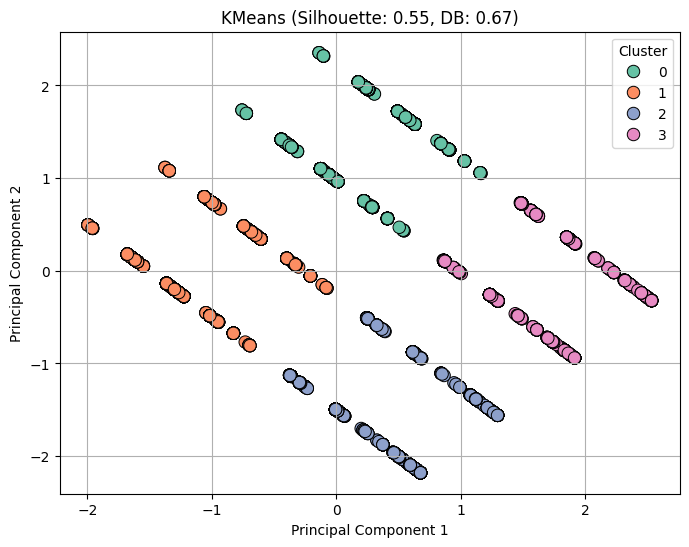

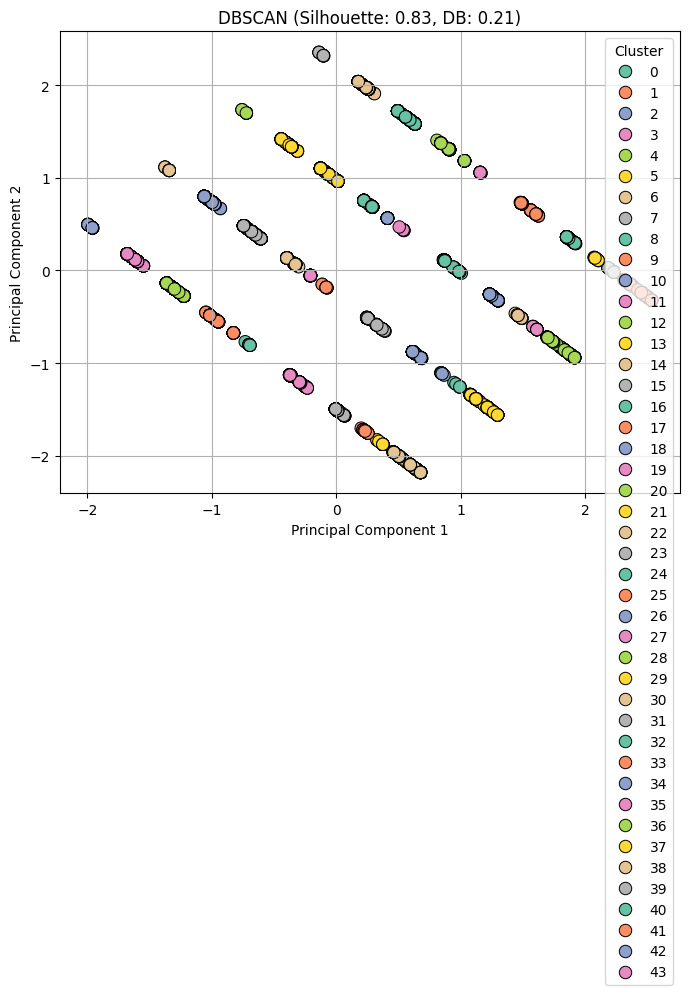

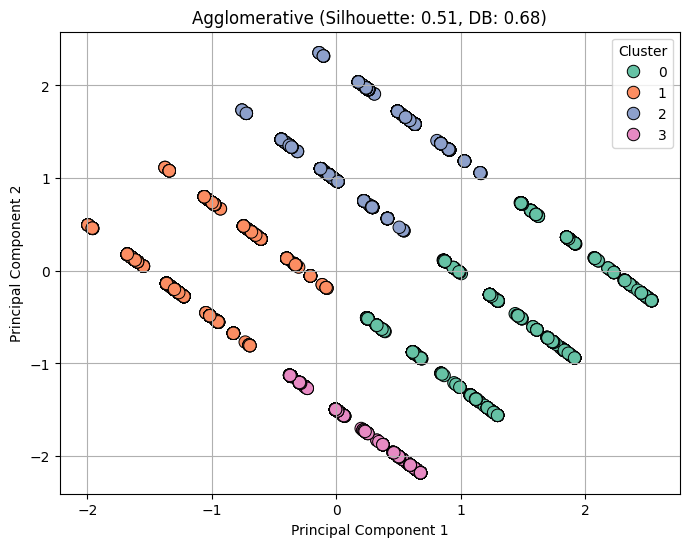

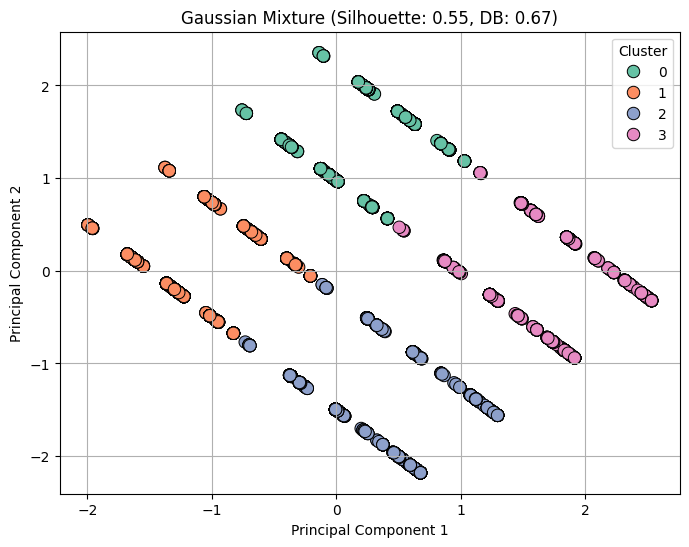

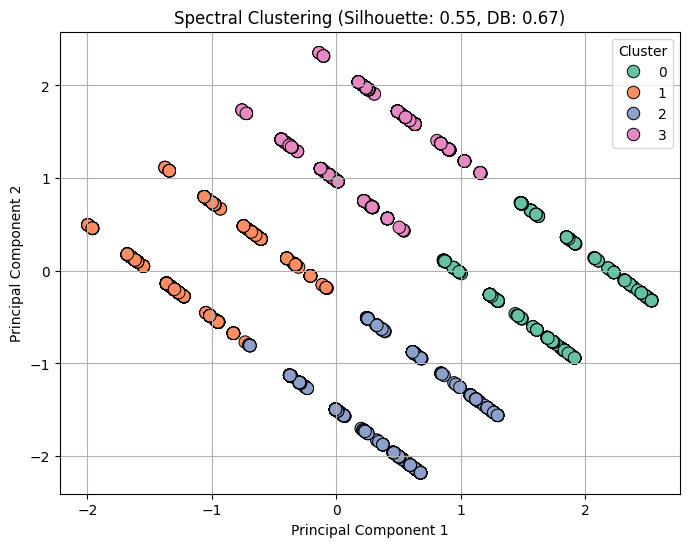


🔍 Clustering Model Ranking:
                 Model  Silhouette  DB Score  Avg Rank
1               DBSCAN    0.834662  0.207843       1.0
0               KMeans    0.549713  0.666343       2.0
4  Spectral Clustering    0.549653  0.666530       3.0
3     Gaussian Mixture    0.549177  0.668811       4.0
2        Agglomerative    0.512944  0.679172       5.0


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering, MeanShift, SpectralClustering
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, davies_bouldin_score

# Input: DataFrame with two principal components
X = principalDf54[['principal component 1', 'principal component 2']]

# Dictionary to store results
results = []

def plot_clusters(X, labels, title):
    plt.figure(figsize=(8, 6))
    sns.scatterplot(x=X.iloc[:, 0], y=X.iloc[:, 1], hue=labels, palette='Set2', s=80, edgecolor='k')
    plt.title(title)
    plt.xlabel("Principal Component 1")
    plt.ylabel("Principal Component 2")
    plt.legend(title="Cluster", loc="best")
    plt.grid(True)
    plt.show()

# Helper function to evaluate and store result
def evaluate_model(name, labels):
    unique_labels = np.unique(labels)
    if len(unique_labels) > 1 and len(set(labels)) != len(X):  # at least 2 clusters and not all unique
        sil_score = silhouette_score(X, labels)
        db_score = davies_bouldin_score(X, labels)
        results.append({'Model': name, 'Silhouette': sil_score, 'DB Score': db_score})
        plot_clusters(X, labels, f"{name} (Silhouette: {sil_score:.2f}, DB: {db_score:.2f})")
    else:
        results.append({'Model': name, 'Silhouette': -1, 'DB Score': np.inf})
        plot_clusters(X, labels, f"{name} (Invalid clustering)")

# KMeans
kmeans = KMeans(n_clusters=4, random_state=42)
evaluate_model("KMeans", kmeans.fit_predict(X))

# DBSCAN
dbscan = DBSCAN(eps=0.1, min_samples=4)
evaluate_model("DBSCAN", dbscan.fit_predict(X))

# Agglomerative
agg = AgglomerativeClustering(n_clusters=4)
evaluate_model("Agglomerative", agg.fit_predict(X))

# MeanShift
# meanshift = MeanShift()
# evaluate_model("MeanShift", meanshift.fit_predict(X))

# Gaussian Mixture Model
gmm = GaussianMixture(n_components=4, random_state=42)
gmm_labels = gmm.fit_predict(X)
evaluate_model("Gaussian Mixture", gmm_labels)

# Spectral Clustering
spectral = SpectralClustering(n_clusters=4, assign_labels='discretize', random_state=42)
evaluate_model("Spectral Clustering", spectral.fit_predict(X))

# Create a summary table
summary_df = pd.DataFrame(results)
summary_df['Rank (Silhouette)'] = summary_df['Silhouette'].rank(ascending=False)
summary_df['Rank (DB Score)'] = summary_df['DB Score'].rank()
summary_df['Avg Rank'] = (summary_df['Rank (Silhouette)'] + summary_df['Rank (DB Score)']) / 2

# Sort by average rank
summary_df = summary_df.sort_values('Avg Rank')
print("\n🔍 Clustering Model Ranking:")
print(summary_df[['Model', 'Silhouette', 'DB Score', 'Avg Rank']])


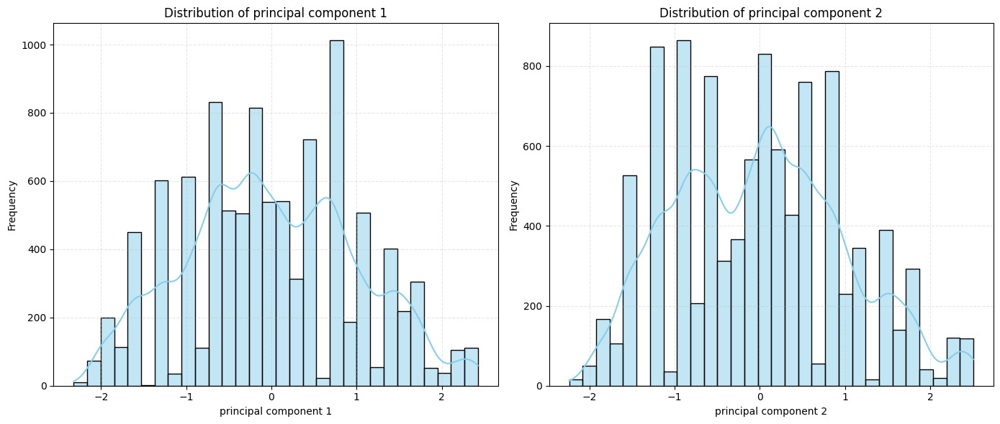

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select principal components
X = principalDf54[['principal component 1', 'principal component 2']]

# Plotting KDE and Histogram
plt.figure(figsize=(14, 6))

for i, col in enumerate(X.columns):
    plt.subplot(1, 2, i+1)
    sns.histplot(X[col], kde=True, bins=30, color='skyblue', edgecolor='black')
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.grid(True, linestyle='--', alpha=0.3)

plt.tight_layout()
plt.show()


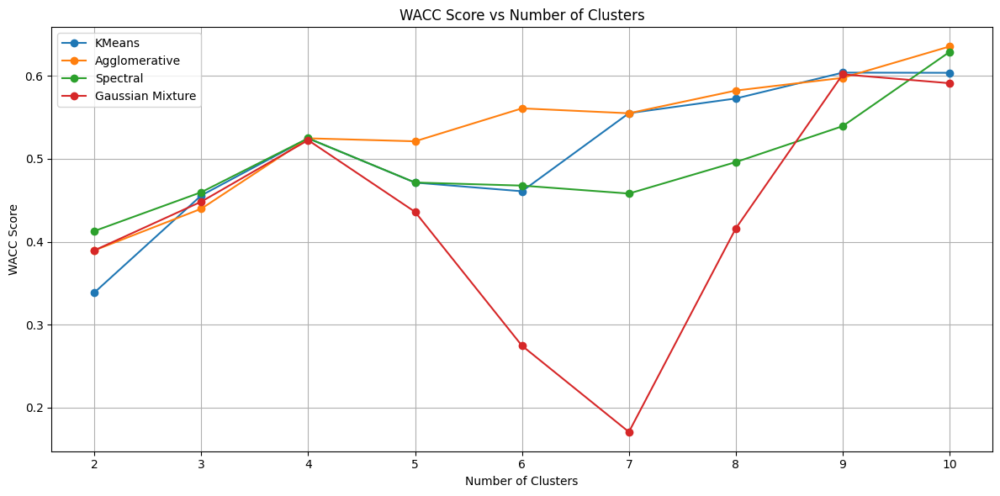

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans, AgglomerativeClustering, SpectralClustering
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_samples

X = principalDf54[['principal component 1', 'principal component 2']]
range_n_clusters = range(2, 11)

# Function to calculate WACC
def compute_wacc(X, labels):
    sil_samples = silhouette_samples(X, labels)
    wacc = 0
    for label in np.unique(labels):
        cluster_sils = sil_samples[labels == label]
        weight = len(cluster_sils) / len(X)
        wacc += weight * np.mean(cluster_sils)
    return wacc

# Store results
results = {
    'KMeans': [],
    'Agglomerative': [],
    'Spectral': [],
    'Gaussian Mixture': []
}

# KMeans
for k in range_n_clusters:
    labels = KMeans(n_clusters=k, random_state=42).fit_predict(X)
    results['KMeans'].append(compute_wacc(X, labels))

# Agglomerative
for k in range_n_clusters:
    labels = AgglomerativeClustering(n_clusters=k).fit_predict(X)
    results['Agglomerative'].append(compute_wacc(X, labels))

# Spectral
for k in range_n_clusters:
    labels = SpectralClustering(n_clusters=k, assign_labels='discretize', random_state=42).fit_predict(X)
    results['Spectral'].append(compute_wacc(X, labels))

# Gaussian Mixture
for k in range_n_clusters:
    gmm = GaussianMixture(n_components=k, random_state=42)
    labels = gmm.fit_predict(X)
    results['Gaussian Mixture'].append(compute_wacc(X, labels))

# Plotting
plt.figure(figsize=(12, 6))
for model_name, wacc_scores in results.items():
    plt.plot(range_n_clusters, wacc_scores, marker='o', label=model_name)

plt.title("WACC Score vs Number of Clusters")
plt.xlabel("Number of Clusters")
plt.ylabel("WACC Score")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


<ipython-input-202-9b32b9da5220>:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Silhouette', y='Model', data=summary_df.sort_values('Silhouette', ascending=False), palette="crest")


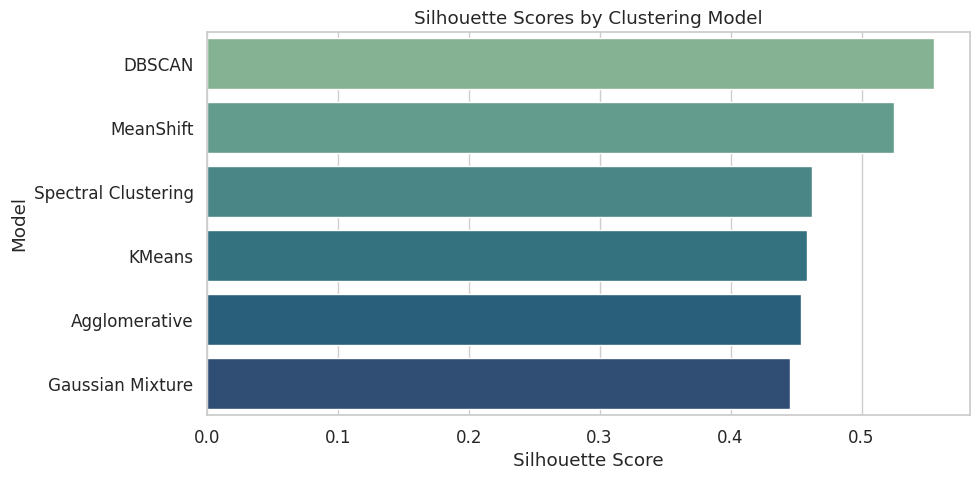

<ipython-input-202-9b32b9da5220>:29: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='DB Score', y='Model', data=summary_df.sort_values('DB Score'), palette="flare")


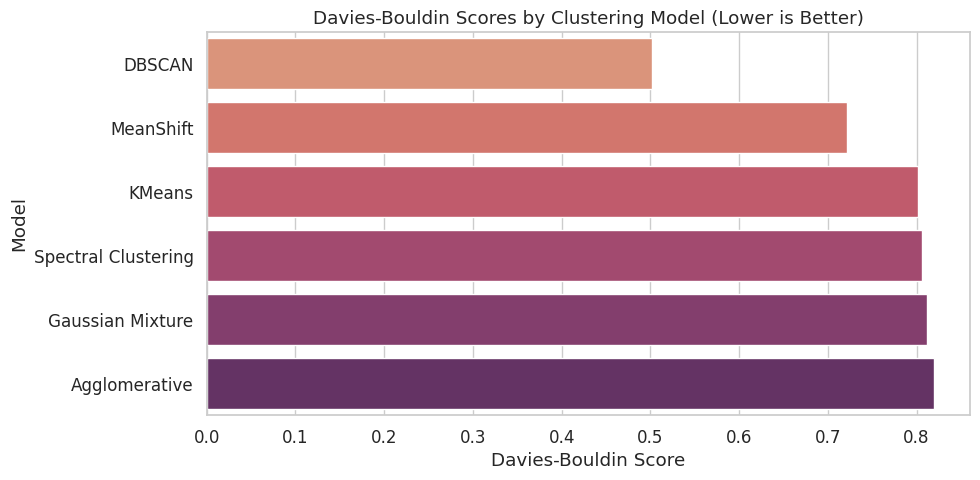

<ipython-input-202-9b32b9da5220>:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Avg Rank', y='Model', data=summary_df.sort_values('Avg Rank'), palette="magma")


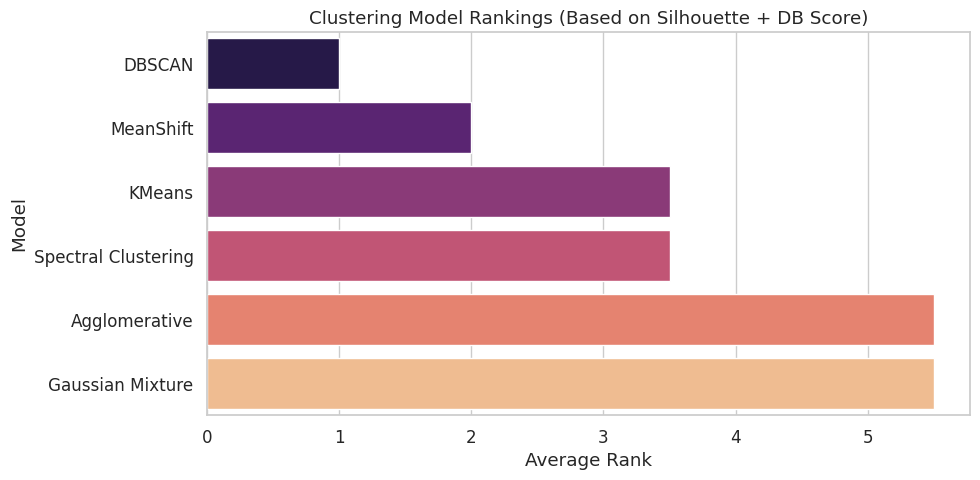

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Use your summary_df from previous output
summary_df = pd.DataFrame({
    'Model': [
        'DBSCAN', 'MeanShift', 'KMeans', 'Spectral Clustering',
        'Agglomerative', 'Gaussian Mixture'
    ],
    'Silhouette': [0.555376, 0.524684, 0.458127, 0.462120, 0.454137, 0.445768],
    'DB Score': [0.502333, 0.721587, 0.801986, 0.806641, 0.819739, 0.812354],
    'Avg Rank': [1.0, 2.0, 3.5, 3.5, 5.5, 5.5]
})

# Set Seaborn style
sns.set(style="whitegrid", font_scale=1.1)

# 1. Silhouette Score Barplot
plt.figure(figsize=(10, 5))
sns.barplot(x='Silhouette', y='Model', data=summary_df.sort_values('Silhouette', ascending=False), palette="crest")
plt.title('Silhouette Scores by Clustering Model')
plt.xlabel('Silhouette Score')
plt.ylabel('Model')
plt.tight_layout()
plt.show()

# 2. Davies-Bouldin Score Barplot
plt.figure(figsize=(10, 5))
sns.barplot(x='DB Score', y='Model', data=summary_df.sort_values('DB Score'), palette="flare")
plt.title('Davies-Bouldin Scores by Clustering Model (Lower is Better)')
plt.xlabel('Davies-Bouldin Score')
plt.ylabel('Model')
plt.tight_layout()
plt.show()

# 3. Average Rank Plot
plt.figure(figsize=(10, 5))
sns.barplot(x='Avg Rank', y='Model', data=summary_df.sort_values('Avg Rank'), palette="magma")
plt.title('Clustering Model Rankings (Based on Silhouette + DB Score)')
plt.xlabel('Average Rank')
plt.ylabel('Model')
plt.tight_layout()
plt.show()


ENDING 2ND EDITED AREA

In [ ]:
# Uninstall related packages


# Reinstall dataprep, which will install compatible versions of its dependencies
!pip install dataprep

# Now try importing and using create_report


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.9/54.9 kB 5.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 5.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.1/154.1 kB 15.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 694.6/694.6 kB 40.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
INFO: pip is looking at multiple versions of nltk to determine which version is compatible with other requirements. This could take a while.
INFO: pip is still looking at multiple versions of nltk to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of nbconvert to determine which version is compatible with other requirements. This could take a while.
INFO: pip is still looking at multiple versions of nbconvert to determine which version is compatible with other requirem

In [ ]:
# Uninstall related packages (already present in user's code)
# !pip uninstall dataprep dask --yes

# Reinstall dataprep, which will install compatible versions of its dependencies
# !pip install dataprep # User's attempt, might not be enough

# Explicitly install dask with the dataframe extras and upgrade
!pip install "dask[dataframe]" --upgrade

# Now try importing and using create_report
from dataprep.datasets import load_dataset
from dataprep.eda import create_report

# Create and display the report
# Assuming 'd' is your DataFrame from previous steps
create_report(d)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.2/102.2 kB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.1/13.1 MB 65.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 47.3 MB/s eta 0:00:00
  Attempting uninstall: click
    Found existing installation: click 7.1.2
    Uninstalling click-7.1.2:
      Successfully uninstalled click-7.1.2
  Attempting uninstall: pandas
    Found existing installation: pandas 1.5.3
    Uninstalling pandas-1.5.3:
      Successfully uninstalled pandas-1.5.3
  Attempting uninstall: dask
    Found existing installation: dask 2.30.0
    Uninstalling dask-2.30.0:
      Successfully uninstalled dask-2.30.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
flask 1.1.4 requires click<8.0,>=5.1, but you have click 8.2.0

RuntimeError: empty_like method already has a different docstring

END EDA

Silhouette Score

In [ ]:
from sklearn.metrics import silhouette_score

SilhouetteTable5['SPECTRAL'] =  [silhouette_score(principalDf54,imp_sample_d_1['cluster4_s'] )]

Davies Bouldin Score

In [ ]:
from sklearn.metrics import davies_bouldin_score
DaviesBouldinTable5['SPECTRAL'] =  [davies_bouldin_score(principalDf54, imp_sample_d_1['cluster4_s'])]

In [ ]:
SilhouetteTable5

In [ ]:
DaviesBouldinTable5

In [ ]:
# print(imp_sample_d_1['Crm Cd'].value_counts().to_string(max_rows=None))

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Combine PCA components and cluster labels into one DataFrame
plot_df = principalDf54.copy()
plot_df['cluster'] = imp_sample_d_1['cluster4_hdb']

# Plot
plt.figure(figsize=(10, 7))
palette = sns.color_palette("hsv", len(plot_df['cluster'].unique()))

sns.scatterplot(
    data=plot_df,
    x='principal component 1',
    y='principal component 2',
    hue='cluster',
    palette=palette,
    legend='full',
    alpha=0.7
)

plt.title('HDBSCAN Clusters Visualized with PCA (2D)', fontsize=14)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
# Algo
import hdbscan

clusterer = hdbscan.HDBSCAN()

cluster_labels = clusterer.fit_predict(principalDf54)

imp_sample_d_1['cluster4_hdb'] = cluster_labels

# Add the plotting code here, right after adding the cluster labels

import matplotlib.pyplot as plt
import seaborn as sns

# Combine PCA components and cluster labels into one DataFrame
# Ensure the column exists in imp_sample_d_1 at this point
plot_df = principalDf54.copy()
plot_df['cluster'] = imp_sample_d_1['cluster4_hdb']

# Plot
plt.figure(figsize=(10, 7))
# Handle the possibility of -1 labels from HDBSCAN
unique_clusters = plot_df['cluster'].unique()
# Sort unique_clusters to ensure consistent color mapping, putting -1 first if it exists
unique_clusters_sorted = sorted(unique_clusters, key=lambda x: (x == -1, x))
palette = sns.color_palette("hsv", len(unique_clusters)) # Use the number of unique clusters for palette size

# Create a mapping for the legend labels
legend_labels = {c: f'Cluster {c}' if c != -1 else 'Noise' for c in unique_clusters_sorted}

# Map the cluster column to string labels for the legend
plot_df['cluster_label'] = plot_df['cluster'].map(legend_labels)


sns.scatterplot(
    data=plot_df,
    x='principal component 1',
    y='principal component 2',
    hue='cluster_label', # Use the new labeled column for hue
    palette=palette,
    legend='full',
    alpha=0.7
)

plt.title('HDBSCAN Clusters Visualized with PCA (2D)', fontsize=14)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.show()

# %% [markdown]
# Silhouette Score
# %%
from sklearn.metrics import silhouette_score

# Calculate Silhouette Score only if there is more than one cluster (excluding noise if present)
# Filter out noise points (-1) for silhouette_score calculation
valid_indices = imp_sample_d_1['cluster4_hdb'] != -1
if len(set(imp_sample_d_1['cluster4_hdb'][valid_indices])) > 1:
    SilhouetteTable5['HDBSCAN'] =  [silhouette_score(principalDf54[valid_indices], imp_sample_d_1['cluster4_hdb'][valid_indices])]
else:
    SilhouetteTable5['HDBSCAN'] = [np.nan] # Or some other indicator for not applicable

# %% [markdown]
# Davies Bouldin Score
# %%
from sklearn.metrics import davies_bouldin_score

# Calculate Davies Bouldin Score only if there is more than one cluster (excluding noise if present)
if len(set(imp_sample_d_1['cluster4_hdb'][valid_indices])) > 1:
    DaviesBouldinTable5['HDBSCAN'] =  [davies_bouldin_score(principalDf54[valid_indices], imp_sample_d_1['cluster4_hdb'][valid_indices])]
else:
    DaviesBouldinTable5['HDBSCAN'] = [np.nan] # Or some other indicator for not applicable

In [ ]:

import matplotlib.pyplot as plt
import seaborn as sns
import hdbscan # Make sure hdbscan is imported
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# ... (Your existing code for data preparation) ...

# HDBSCAN clustering (re-run this section to create the 'cluster4_hdb' column if needed)
imp_sample_d_13 = imp_sample_d_1.drop(['cluster2_hdb','Premis Cd','cluster1_hdb'],axis = 1)
#imp_sample_d_13.head(1)
sc = StandardScaler()
allcomb54 = sc.fit_transform(imp_sample_d_13)
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(allcomb54)
principalDf54 = pd.DataFrame(data = principalComponents, columns = ['principal component 1', 'principal component 2'])
clusterer = hdbscan.HDBSCAN()
cluster_labels = clusterer.fit_predict(principalDf54)
imp_sample_d_1['cluster4_hdb'] = cluster_labels # This line creates the 'cluster4_hdb' column

# ... (Your existing code for Silhouette and Davies Bouldin Scores) ...

# Combine PCA components and cluster labels into one DataFrame
plot_df = principalDf54.copy()
plot_df['cluster'] = imp_sample_d_1['cluster4_hdb']

# Plot
plt.figure(figsize=(10, 7))
palette = sns.color_palette("hsv

In [ ]:
!pip install dataprep
from dataprep.eda import create_report
create_report(d)
create_report(principalDf54)

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Combine PCA components and cluster labels into one DataFrame
plot_df = principalDf54.copy()

# Assuming 'cluster4_hdb' is the column containing the HDBSCAN cluster labels
# Ensure this column still exists in your DataFrame
# If you've overwritten this column in a previous step, re-run the HDBSCAN clustering to regenerate it.
# plot_df['cluster'] = imp_sample_d_1['cluster4_hdb']

# To avoid the KeyError, access the labels directly from the clustering results
plot_df['cluster'] = labels  # Use the cluster labels from HDBSCAN clustering

# Plot
plt.figure(figsize=(10, 7))
palette = sns.color_palette("hsv", len(plot_df['cluster'].unique()))

sns.scatterplot(
    data=plot_df,
    x='principal component 1',
    y='principal component 2',
    hue='cluster',
    palette=palette,
    legend='full',
    alpha=0.7
)

plt.title('HDBSCAN Clusters Visualized with PCA (2D)', fontsize=14)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
import matplotlib.pyplot as plt
import seaborn as sns

# Clustering models
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans_labels = kmeans.fit_predict(principalDf54)

dbscan = DBSCAN(eps=0.5, min_samples=5)
dbscan_labels = dbscan.fit_predict(principalDf54)

agglo = AgglomerativeClustering(n_clusters=5)
agglo_labels = agglo.fit_predict(principalDf54)

# Plotting function
def plot_clusters(pca_df, labels, title):
    plot_df = pca_df.copy()
    plot_df['cluster'] = labels

    plt.figure(figsize=(10, 7))
    palette = sns.color_palette("hsv", len(set(labels)) if -1 not in set(labels) else len(set(labels)) - 1 + 1)

    sns.scatterplot(
        data=plot_df,
        x='principal component 1',
        y='principal component 2',
        hue='cluster',
        palette=palette,
        legend='full',
        alpha=0.7
    )

    plt.title(title, fontsize=14)
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Generate plots
plot_clusters(principalDf54, kmeans_labels, 'KMeans Clusters Visualized with PCA (2D)')
plot_clusters(principalDf54, dbscan_labels, 'DBSCAN Clusters Visualized with PCA (2D)')
plot_clusters(principalDf54, agglo_labels, 'Agglomerative Clusters Visualized with PCA (2D)')
